## Preparation

### Import Library

In [1]:
import skimage.io as io
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt
from collections import defaultdict
from numba import jit

import math

### Init Setting

In [2]:
try:
    print(ROOT) # ROOT
except:
    ROOT = os.getcwd().replace('\\\\', '\\')
    print(ROOT)


C:\Users\Gliver\OneDrive - jbnu.ac.kr\# JSM\# 2023\[2023] CvLab\Graduation Project\Codes


In [3]:
MAX = 255


# crop_names
crop_names = ['banana', 'carrot', 'onion', 'orange', 'pimento', 'sweet_potato']
images = defaultdict(bool)

# images
for crop_name in crop_names:
    for i, pn in enumerate(['negative', 'positive']):
        path = rf'{ROOT}\images\{crop_name}\{pn}'
        img_list = []
        
        file_list = os.listdir(path)
        os.chdir(path)
        
        for file in file_list:
            img = cv2.imread(file, 0)
            img_list.append(img)
            
        images[(crop_name, i)] = img_list

### Define Function

In [4]:
def alert():
    print('입력 인자가 정상이 아님')
    return False

# plt setting
def plt_setting(inum, cnum=2, hsize=0, wsize=0):
    nrow = (inum+cnum-1) // cnum
    if hsize*wsize == 0:
        hsize, wsize = 7*nrow, 15
    
    fig, axs = plt.subplots(nrows=nrow, ncols=cnum, figsize=(wsize, hsize))
    plt.subplots_adjust(hspace = 0.5)
    
    return fig, axs


# show imgs & info
def show_img_and_info(crop='banana', pn=0): # crop_names = ['banana', 'carrot', 'onion', 'orange', 'pimento', 'sweet_potato']
    img_list = images[(crop, pn)]
    if not img_list:
        return alert()
    
    num = len(img_list)
    print(crop, num)
    
    fig, axs = plt_setting(num)
    
    for img, ax in zip(img_list, axs.flat):
        ax.imshow(img, cmap=plt.cm.gray)
        ax.set_xlabel(img.shape, labelpad=10)
    

def show_binary_imgs(threshold, crop='banana', pn=0):
    img_list = images[(crop, pn)]
    if not img_list:
        return alert()
    
    fig, axs = plt_setting(len(img_list))
    
    for img, ax in zip(img_list, axs.flat):
        img = np.where(img>=threshold, MAX, 0)

        ax.imshow(img, cmap=plt.cm.gray)
        ax.set_xlabel(img.shape, labelpad=10)
        
        
# print histogram distribution
def print_histogram(img, info):
    pcnt = np.zeros(256, dtype=np.int32) # pixel_count
    for i in range(256):
        pcnt[i] = np.sum(np.where(np.logical_and(info==1, img==i), 1, 0))
        
    x = np.arange(256)
    plt.title('Histogram')
    plt.bar(x, pcnt)
    plt.show()
    

def stretching(img, info):
    low = np.min(img)
    high = np.max(np.where(info==1, img, 0))
    
    
    lfunc = lambda x: np.uint8(min((x-low)/(high-low)*MAX, MAX))
    vfunc = np.vectorize(lfunc)
    ret = vfunc(img)
    return ret

## Data Analysis

### show image info
- 이미지는 모두 <b>명암영상</b>
- 이미지의 크기는 (height, width) = (800, 1024) or (400, 1024)

In [5]:
for crop in crop_names:
    print(crop)
    for pn in [0, 1]:
        print(pn, images[(crop, pn)][0].shape)

banana
0 (800, 1024)
1 (800, 1024)
carrot
0 (800, 1024)
1 (800, 1024)
onion
0 (400, 1024)
1 (800, 1024)
orange
0 (800, 1024)
1 (800, 1024)
pimento
0 (400, 1024)
1 (400, 1024)
sweet_potato
0 (400, 1024)
1 (800, 1024)


#### 'banana' image info

banana 6


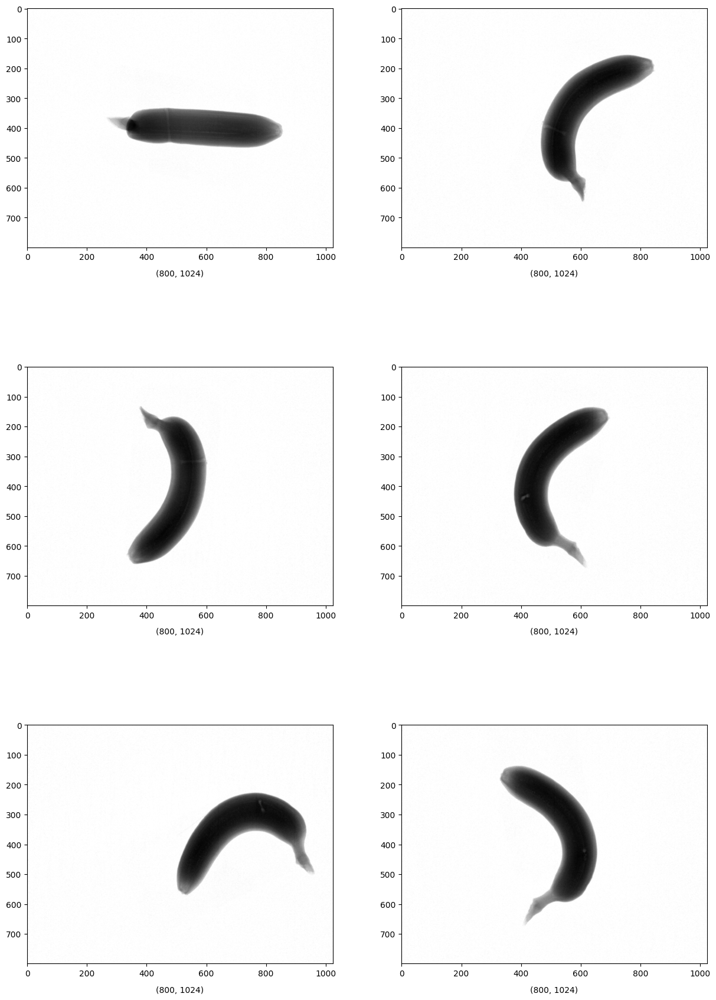

In [6]:
show_img_and_info('banana') # negative

banana 8


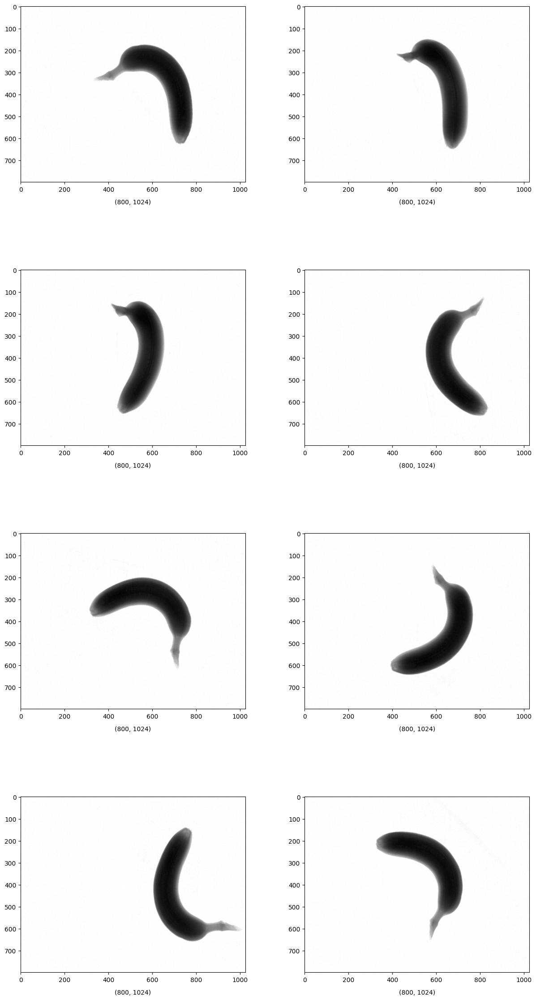

In [7]:
show_img_and_info('banana', 1) # positive

#### 'carrot' image info

carrot 5


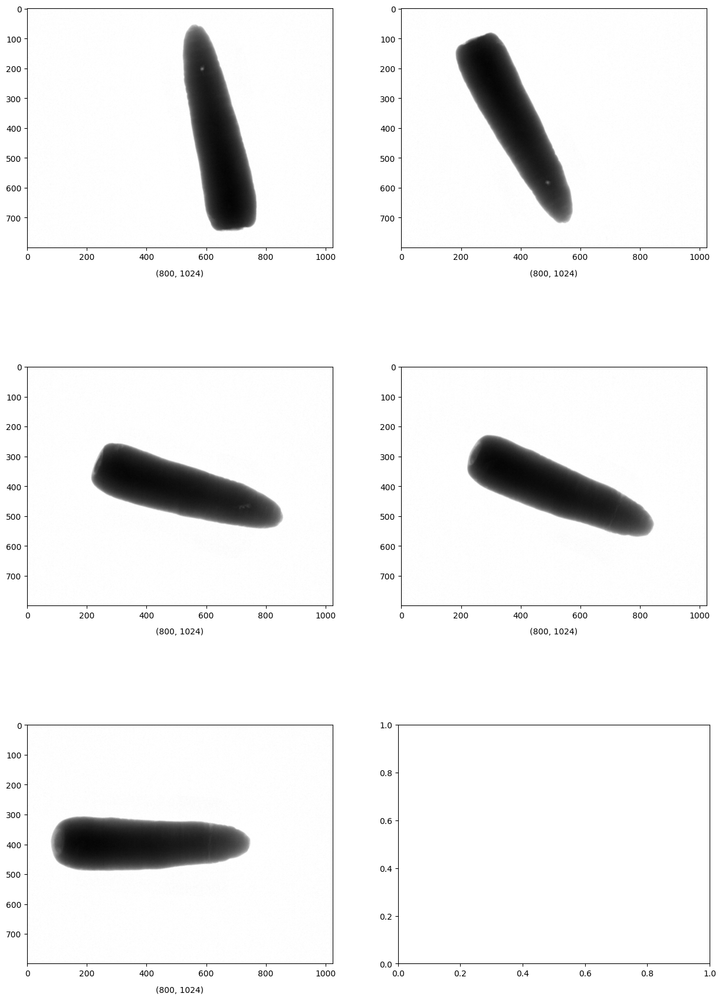

In [8]:
show_img_and_info('carrot') # negative

carrot 5


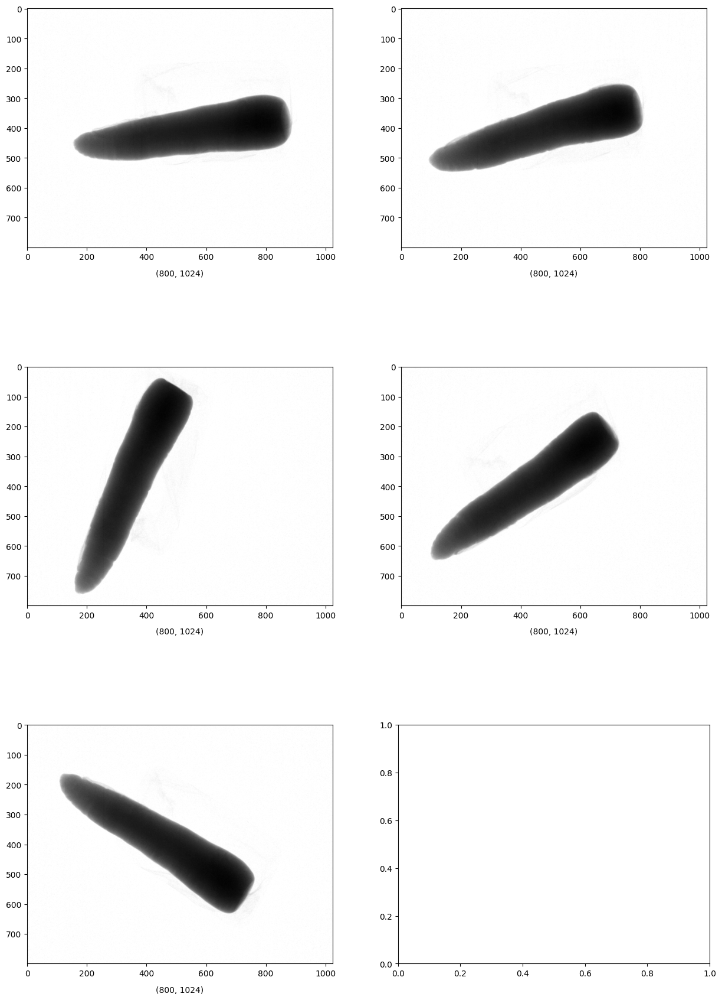

In [9]:
show_img_and_info('carrot', 1) # positive

#### 'onion' image info

onion 10


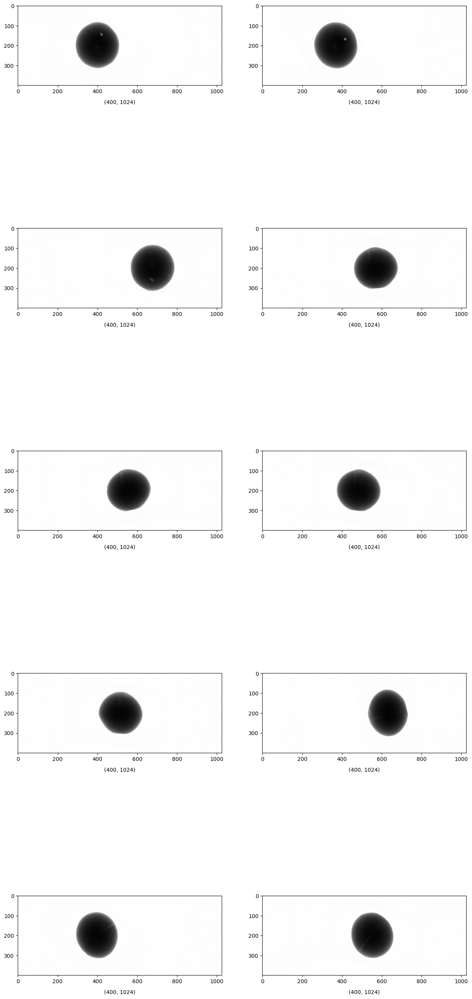

In [10]:
show_img_and_info('onion') # negative

onion 10


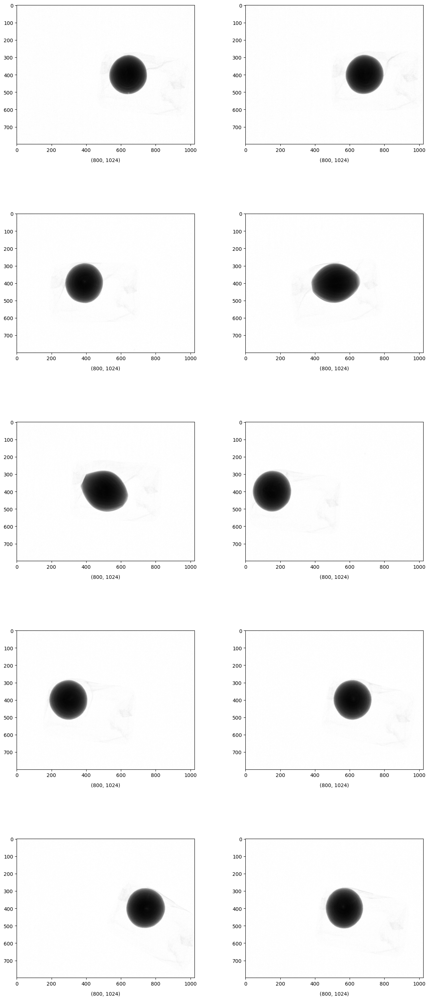

In [11]:
show_img_and_info('onion', 1) # positive

#### 'orange' image info

orange 7


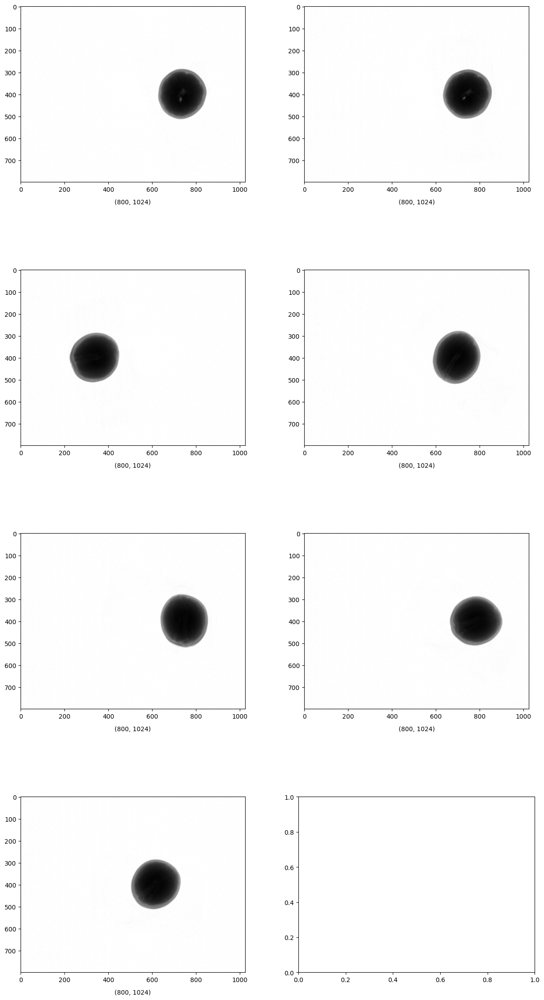

In [12]:
show_img_and_info('orange') # negative

orange 10


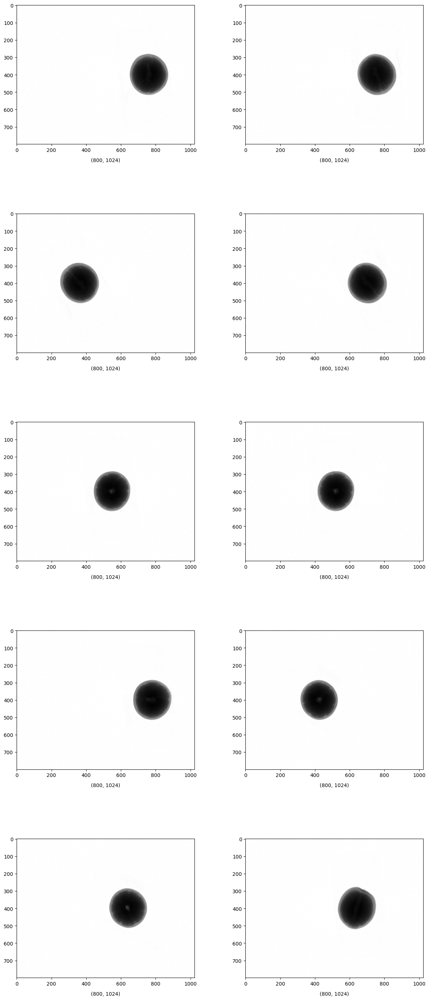

In [13]:
show_img_and_info('orange', 1) # positive

#### 'pimento' image info

pimento 4


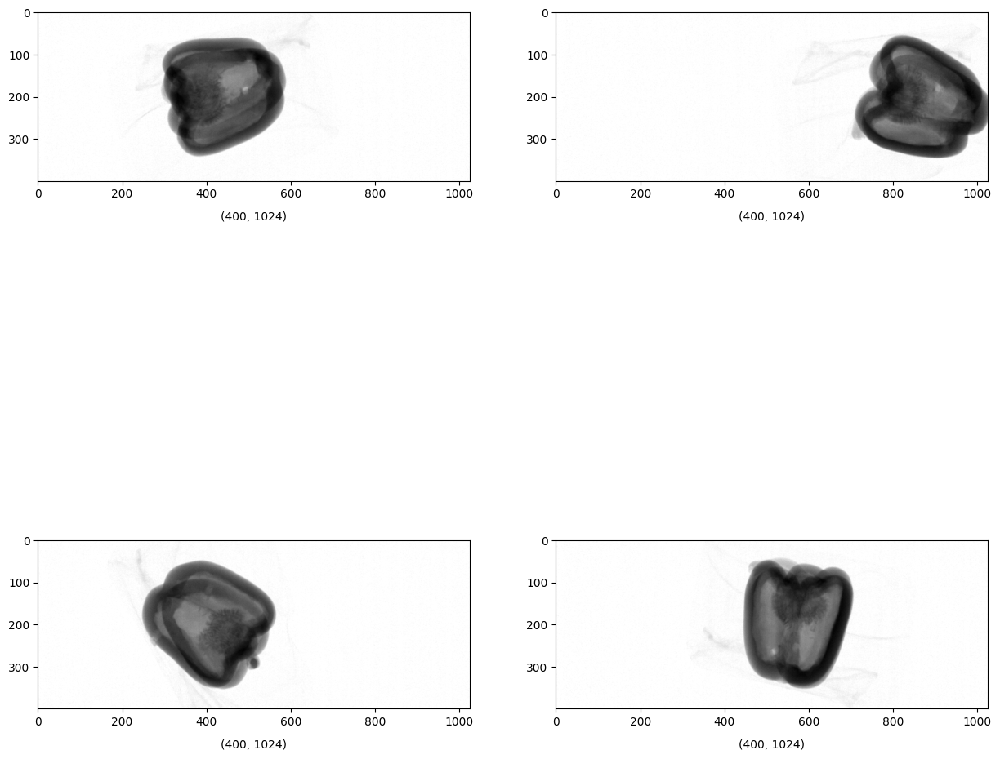

In [14]:
show_img_and_info('pimento') # negative

pimento 5


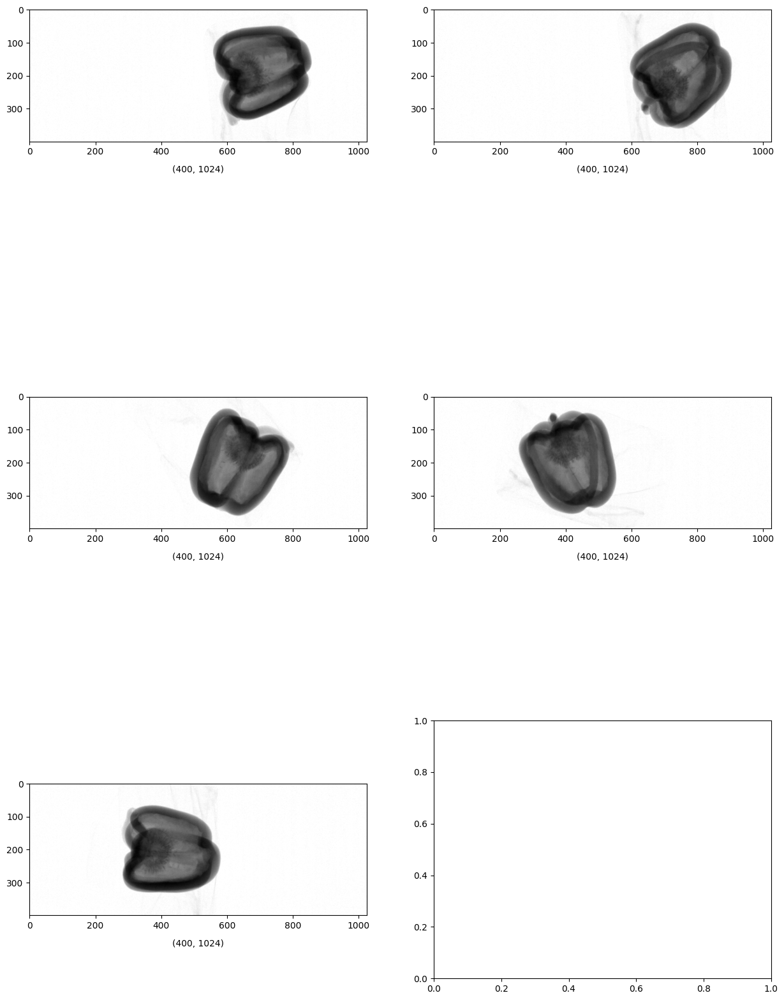

In [15]:
show_img_and_info('pimento', 1) # positive

#### 'sweet potato' image info

sweet_potato 6


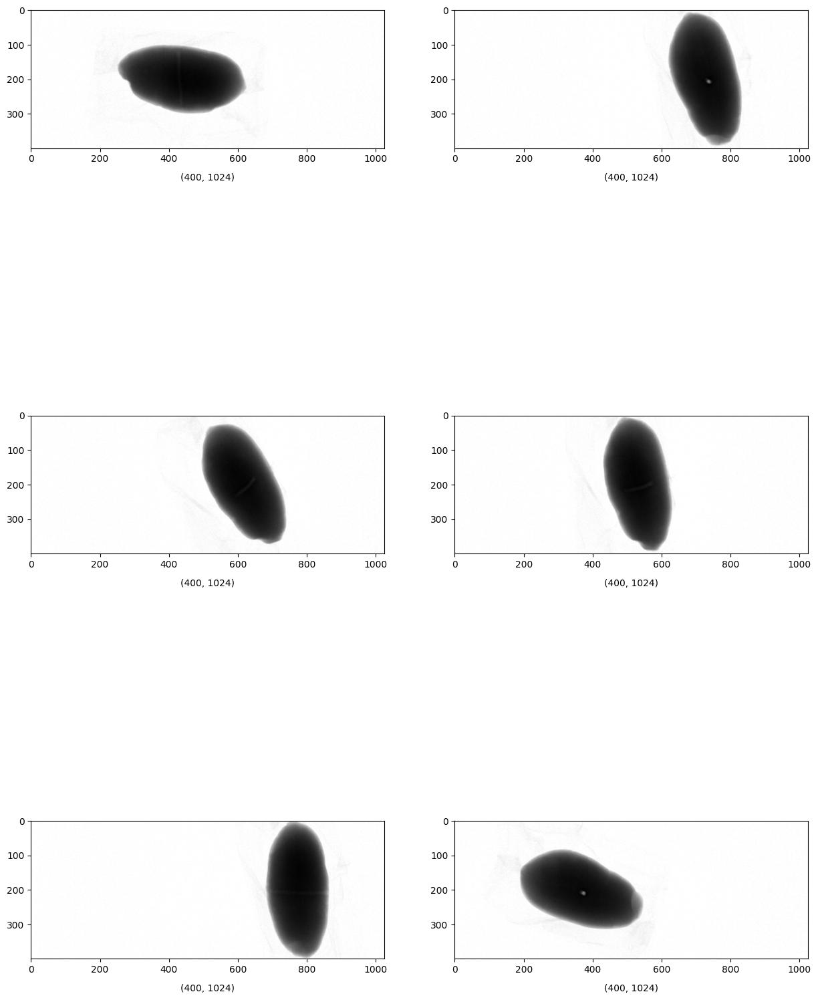

In [16]:
show_img_and_info('sweet_potato') # negative

sweet_potato 8


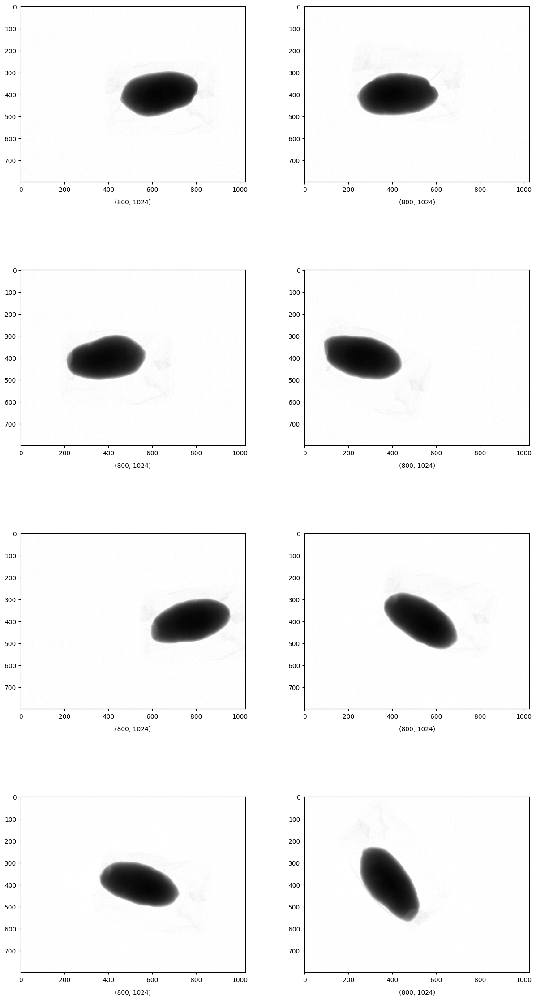

In [17]:
show_img_and_info('sweet_potato', 1) # positive

### Processing (grayscale) Image

C:\Users\Gliver\AppData\Local\Temp\ipykernel_13968\1717859401.py:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  sample_list = np.array(list(sample_zip)).flatten()


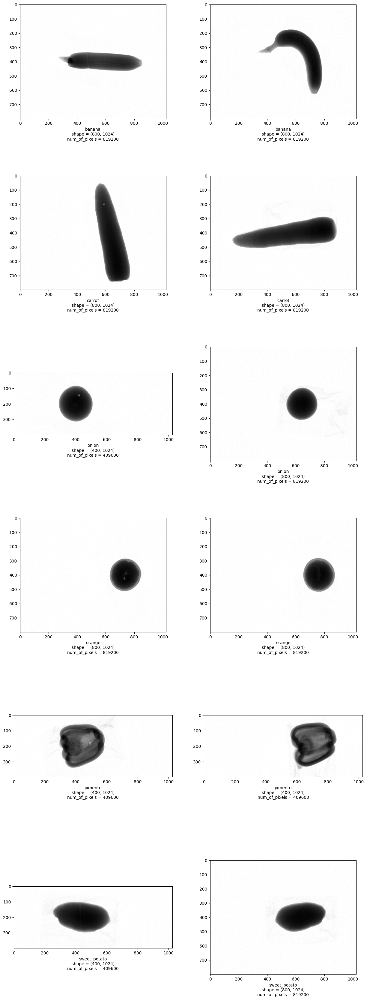

In [18]:
# we use this image as basic (neg 6, pos 6)
neg_sample = []
pos_sample = []

for crop in crop_names:
    for pn in [0, 1]:
        if pn == 0:
            neg_sample.append(images[(crop, pn)][0])
        if pn == 1:
            pos_sample.append(images[(crop, pn)][0])
            
fig, axs = plt_setting(12, 2)

sample_zip = zip(neg_sample, pos_sample)
sample_list = np.array(list(sample_zip)).flatten()
for i, (img, ax) in enumerate(zip(sample_list, axs.flat)):
    text = f'{crop_names[i//2]}\n' + f'shape = {img.shape}\n' + f'num_of_pixels = {img.size}'
    ax.set_xlabel(text)
    ax.imshow(img, cmap=plt.cm.gray)


#### Analyze using binarization

In [19]:
def show_binary_imgs(threshold, img_list=sample_list):
    fig, axs = plt_setting(len(img_list))
    
    ret = []
    for i, (img, ax) in enumerate(zip(img_list, axs.flat)):
        img = np.where(img>=threshold, MAX, 0)
        ret.append(np.copy(img))
        
        ax.set_xlabel(crop_names[i//2])
        ax.imshow(img, cmap=plt.cm.gray)
    
    return ret

- Case2. <code>threshold = 255</code>

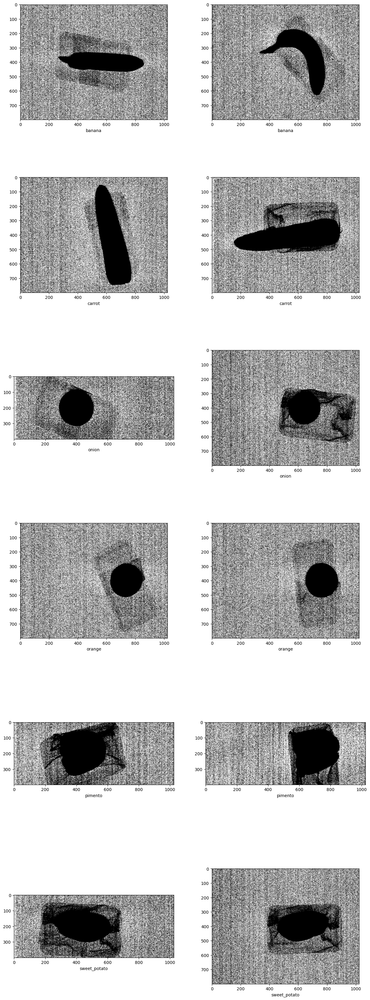

In [20]:
bsample255 = show_binary_imgs(255)

- Case2. <code>threshold = 250</code>

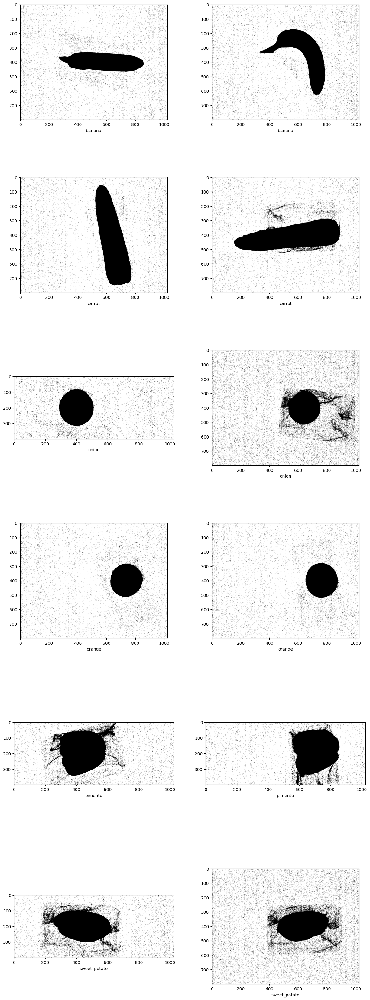

In [21]:
bsample250 = show_binary_imgs(250)

- Case3. <code>threshold = 245</code>

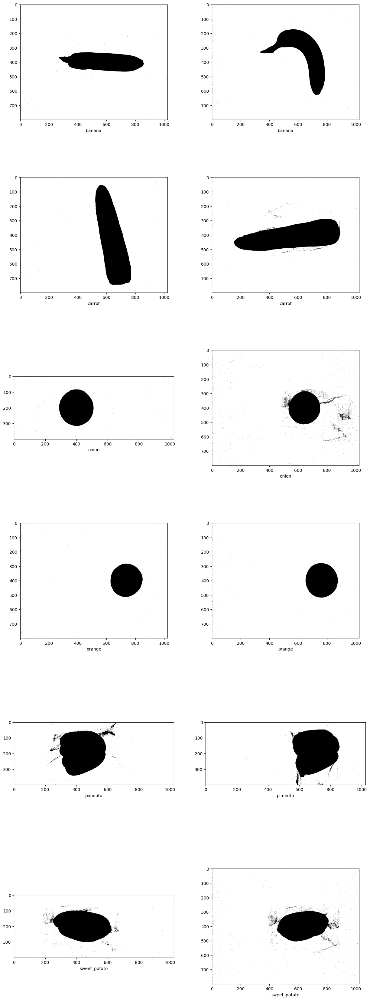

In [22]:
bsample245 = show_binary_imgs(245)

- Case4. <code>threshold = 240</code>

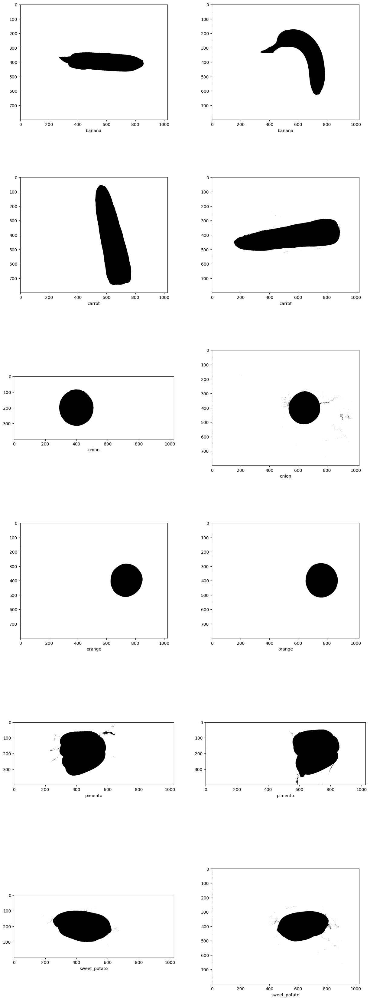

In [23]:
bsample240 = show_binary_imgs(240)

- Case5. <code>threshold = 200</code>

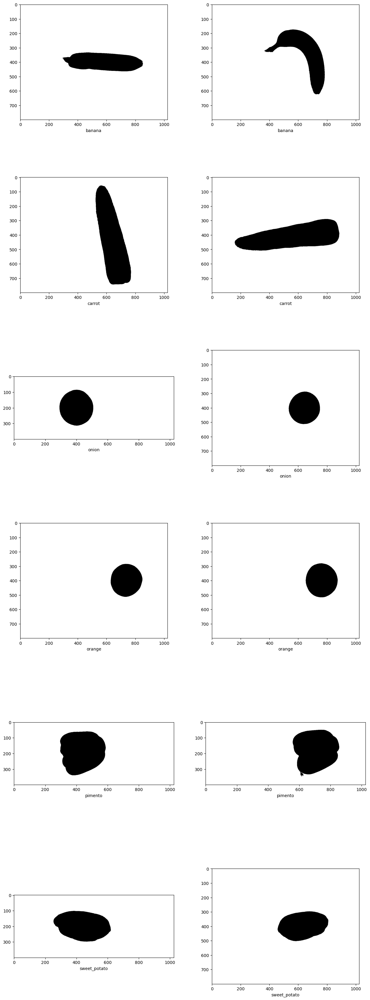

In [24]:
bsample200 = show_binary_imgs(200)

- Case6. <code>threshold = 100</code>

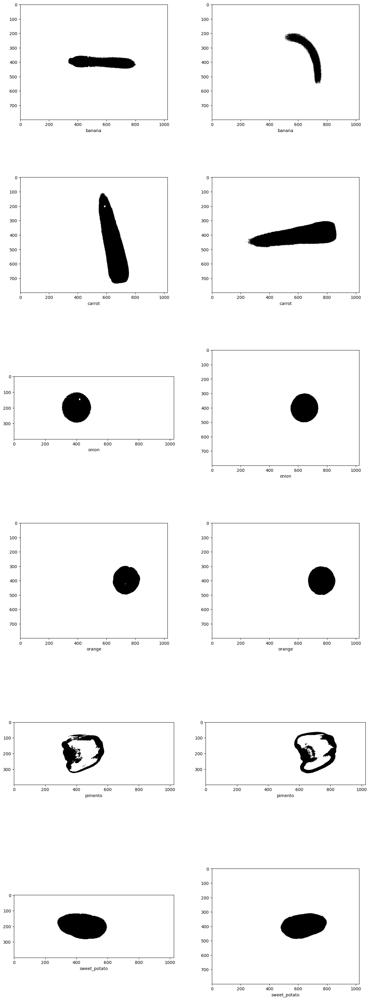

In [25]:
bsample100 = show_binary_imgs(100)

- Case7. <code>threshold=240</code> and opening operation

In [26]:
def convert_binary_oppening(img, threshold, num):
    se = np.uint8([[0,0,1,0,0],  # shape
                   [0,1,1,1,0],
                   [1,1,1,1,1],
                   [0,1,1,1,0],
                   [0,0,1,0,0]])
    
    ret = np.where(img >= threshold, MAX, 0).astype(np.uint16)
    ret = cv2.dilate(ret, se, iterations=num)
    ret = cv2.erode(ret , se , iterations=num)
    
    return ret
    

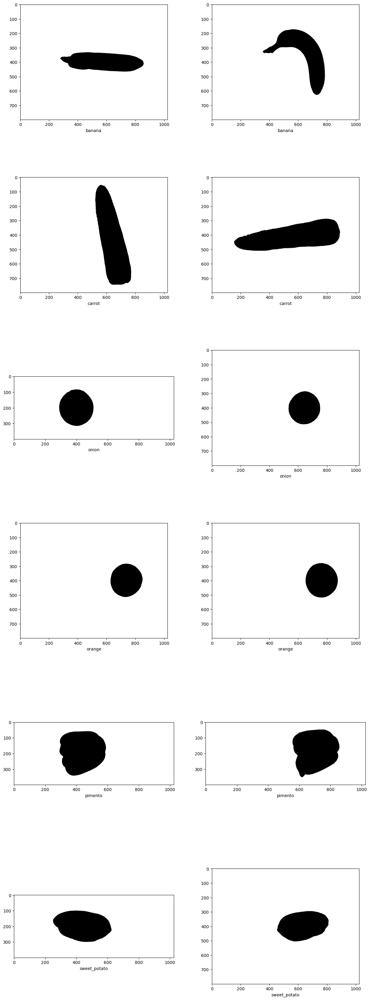

In [27]:
bsample240_open = []

se = np.uint8([[0,0,1,0,0],  # shape
               [0,1,1,1,0],
               [1,1,1,1,1],
               [0,1,1,1,0],
               [0,0,1,0,0]])

fig, axs = plt_setting(len(sample_list))

for i, (img, ax) in enumerate(zip(sample_list, axs.flat)):
    img = np.where(img >= 240, MAX, 0).astype(np.uint16)
    img = cv2.dilate(img, se, iterations=5)
    img = cv2.erode(img, se, iterations=5)
    
    bsample240_open.append(np.copy(img))
    
    ax.set_xlabel(crop_names[i//2])
    ax.imshow(img, cmap=plt.cm.gray)
    


- 두 이미지 차이 시각화 하는 함수

In [28]:
def diff_show(blist1, blist2):
    fig, axs = plt_setting(len(blist1))
    
    for img1, img2, ax in zip(blist1, blist2, axs.flat):
        diff = np.where(img1 == img2, MAX, 0)
        ax.imshow(diff, cmap=plt.cm.gray)

- <code>threshold=240</code>과 <code>threshold=200</code> 차이 비교

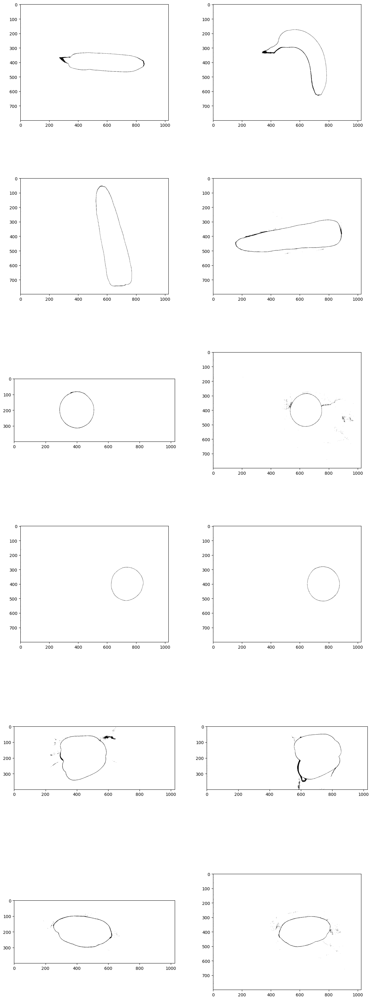

In [29]:
diff_show(bsample240, bsample200)

- <code>threshold=240</code>과 <code>threshold=240</code>에 열림 연산(5) 적용한 결과 차이 비교

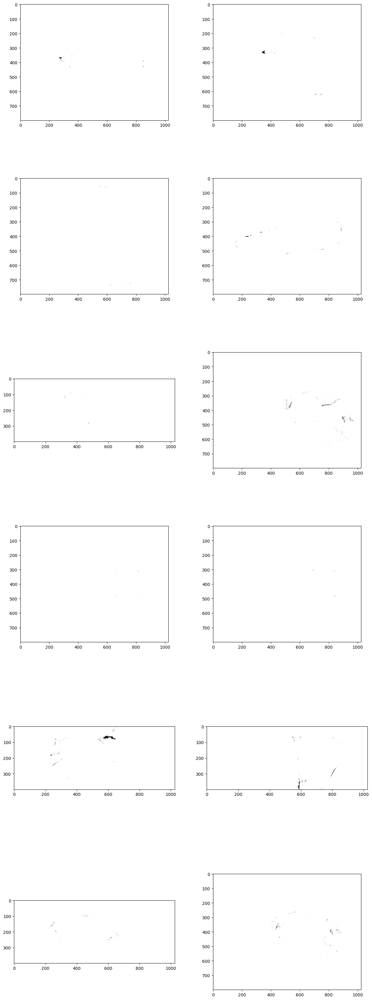

In [30]:
diff_show(bsample240, bsample240_open)

#### ----- Then, we are progressing using <code>threshold=240</code>and openning operation(침식5, 팽창5)</b>

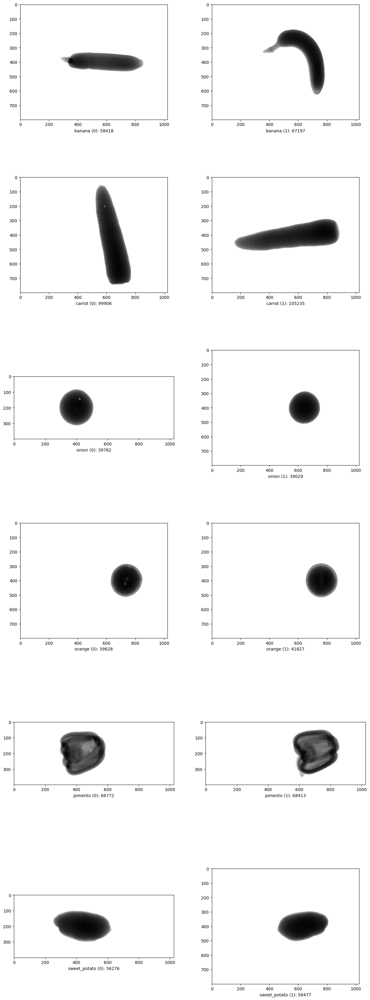

In [31]:
fig, axs = plt_setting(len(bsample240_open))

basic_infos = []
basic_imgs = []
for i, (img, ax) in enumerate(zip(bsample240_open, axs.flat)):
    basic_info = np.where(img==0, 1, 0)
    basic_img = np.where(basic_info==1, sample_list[i], MAX)
    
    basic_infos.append(basic_info)
    basic_imgs.append(basic_img)
    
    text = f'{crop_names[i//2]} ({i%2}): {np.sum(basic_info)}'
    ax.set_xlabel(text)    
    ax.imshow(basic_img, cmap=plt.cm.gray)
    

- print histogram function

In [32]:
def print_histogram(imgs, infos, flag=True):
    print('Histogram')
    fig, axs = plt_setting(len(imgs))
    
    pcnts = []
    for i, (img, info, ax) in enumerate(zip(imgs, infos, axs.flat)):
        pcnt = np.zeros(MAX+1, dtype=np.int32) # pixel_count
        
        notw_img = np.where(info==0, -1, img)
        uniq, cnts = np.unique(notw_img, return_counts=True)
        uniq_cnt_dict = dict(zip(uniq, cnts))
        
        for a, b in uniq_cnt_dict.items():
            if a == -1: continue
            pcnt[a] = b;
        
        if flag: 
            x = np.arange(MAX+1)
            
            text = f'{crop_names[i//2]} ({i%2})'
            ax.set_xlabel(text)    
            ax.bar(x, pcnt)
            
        pcnts.append(pcnt)
        
    return pcnts

Histogram


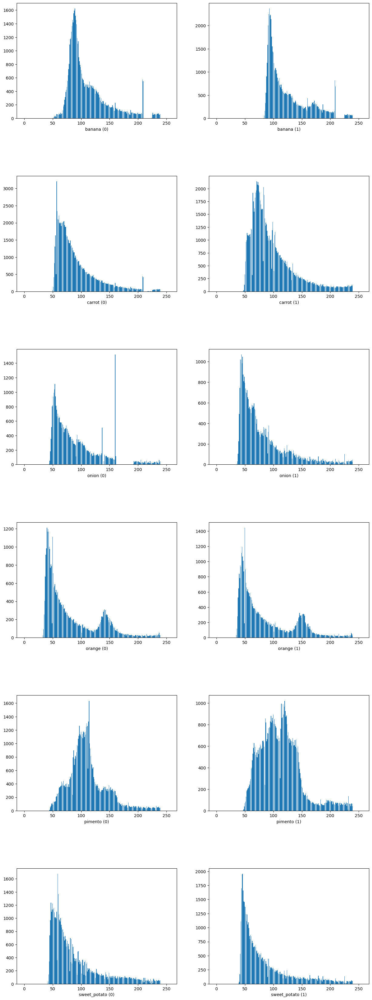

In [33]:
bimg_hists = print_histogram(basic_imgs, basic_infos)

Sum_Histogram


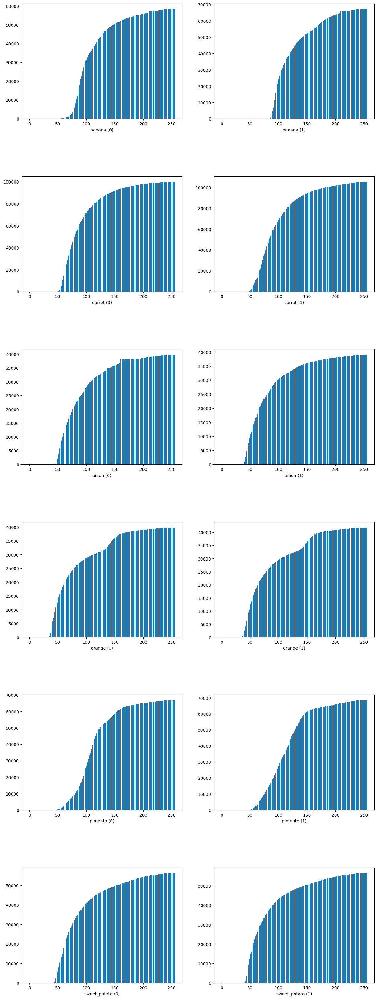

In [34]:
print('Sum_Histogram')
fig, axs = plt_setting(len(basic_imgs))

x = np.arange(256)
for i, ax in enumerate(axs.flat):
    
    text = f'{crop_names[i//2]} ({i%2})'
    ax.set_xlabel(text) 
    ax.bar(x, np.cumsum(bimg_hists[i]))

#### Stretching

- stretching function

In [35]:
def stretching(img, info):
    low = np.min(img)
    high = np.max(np.where(info==1, img, 0))
#     print(low, high)
    
    def func(x):
        if x == MAX:
            return MAX
        return np.uint8((x-low)/(high-low) * MAX)
    
    vfunc = np.vectorize(func)
    ret = vfunc(img)
    return ret

- <code>simg</code> (is a image after stretching)

banana(0): (800, 1024)
banana(1): (800, 1024)
carrot(0): (800, 1024)
carrot(1): (800, 1024)
onion(0): (400, 1024)
onion(1): (800, 1024)
orange(0): (800, 1024)
orange(1): (800, 1024)
pimento(0): (400, 1024)
pimento(1): (400, 1024)
sweet_potato(0): (400, 1024)
sweet_potato(1): (800, 1024)


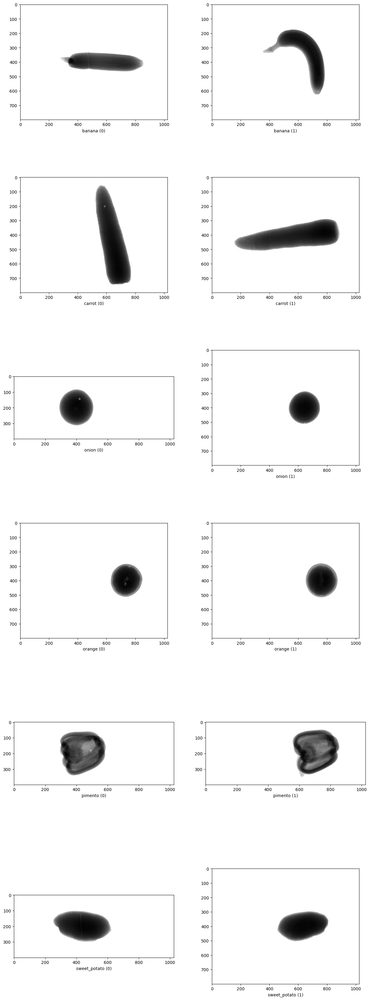

In [36]:
simgs = []

for i, (img, info) in enumerate(zip(basic_imgs, basic_infos)):
    simgs.append(stretching(img, info))
    print(f'{crop_names[i//2]}({i%2}): {img.shape}')
    
fig, axs = plt_setting(len(simgs))

for i, (img, ax) in enumerate(zip(simgs, axs.flat)):
    ax.set_xlabel(f'{crop_names[i//2]} ({i%2})')
    ax.imshow(img, cmap=plt.cm.gray)

Histogram


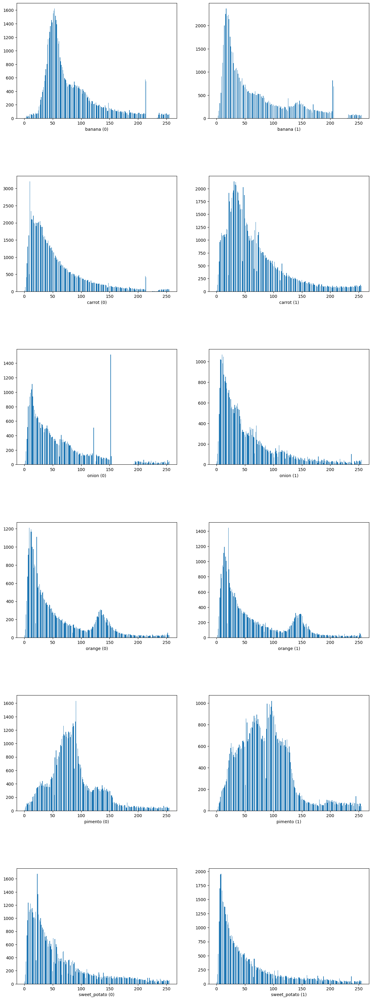

In [37]:
simg_hists = print_histogram(simgs, basic_infos)

Sum_Histogram


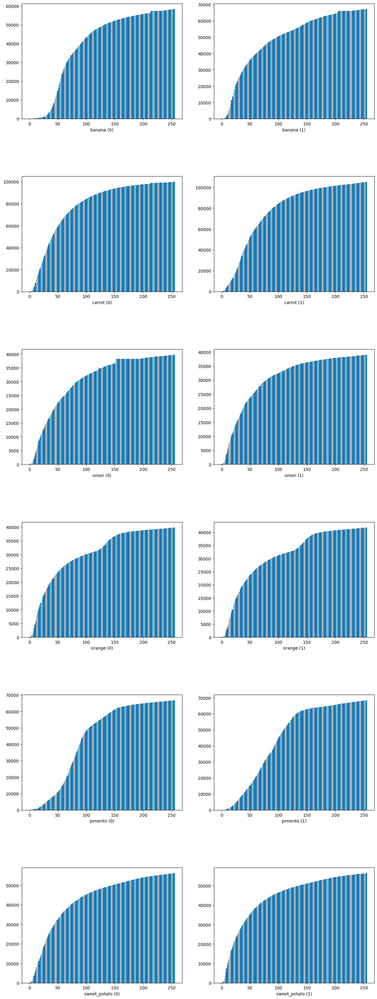

In [38]:
print('Sum_Histogram')
fig, axs = plt_setting(len(simgs))

x = np.arange(256)
for i, ax in enumerate(axs.flat):
    
    text = f'{crop_names[i//2]} ({i%2})'
    ax.set_xlabel(text) 
    ax.bar(x, np.cumsum(simg_hists[i]))

#### Histogram Equalization

- histogram equalizing function

In [39]:
def hist_equalize(img, h, info):
    hn = h / np.sum(h)
    hn_sum = np.cumsum(hn)
    
    lfunc = lambda x : np.uint16(np.round(hn_sum[x] * MAX))
    ret = np.where(info==1, lfunc(img), MAX)
    
    return ret

- <code>himg</code> (= image after histogram equalization)

banana(0): (800, 1024)
banana(1): (800, 1024)
carrot(0): (800, 1024)
carrot(1): (800, 1024)
onion(0): (400, 1024)
onion(1): (800, 1024)
orange(0): (800, 1024)
orange(1): (800, 1024)
pimento(0): (400, 1024)
pimento(1): (400, 1024)
sweet_potato(0): (400, 1024)
sweet_potato(1): (800, 1024)


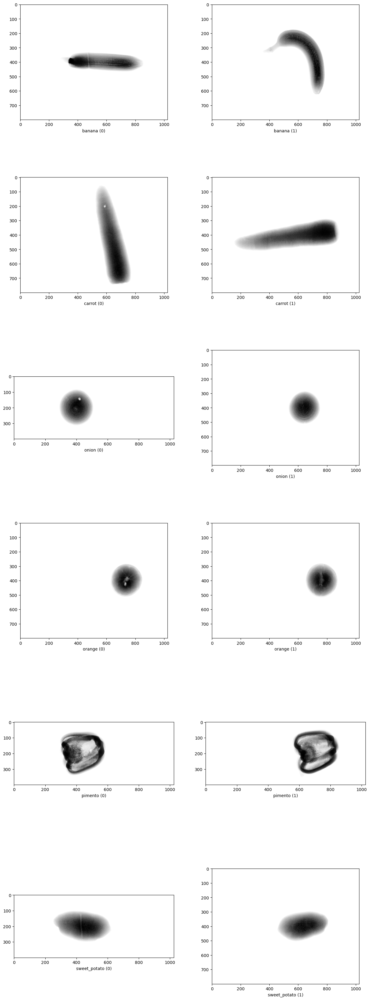

In [40]:
himgs = []

for i, (img, hist, info) in enumerate(zip(basic_imgs, bimg_hists, basic_infos)):
    himgs.append(hist_equalize(img, hist, info))
    print(f'{crop_names[i//2]}({i%2}): {img.shape}')
    
fig, axs = plt_setting(len(simgs))

for i, (img, ax) in enumerate(zip(himgs, axs.flat)):
    ax.set_xlabel(f'{crop_names[i//2]} ({i%2})')
    ax.imshow(img, cmap=plt.cm.gray)

Histogram


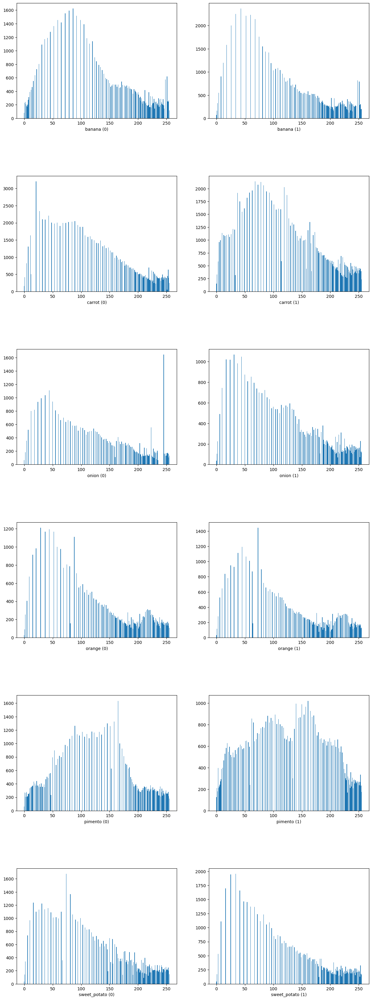

In [41]:
himg_hists = print_histogram(himgs, basic_infos)

Sum_Histogram


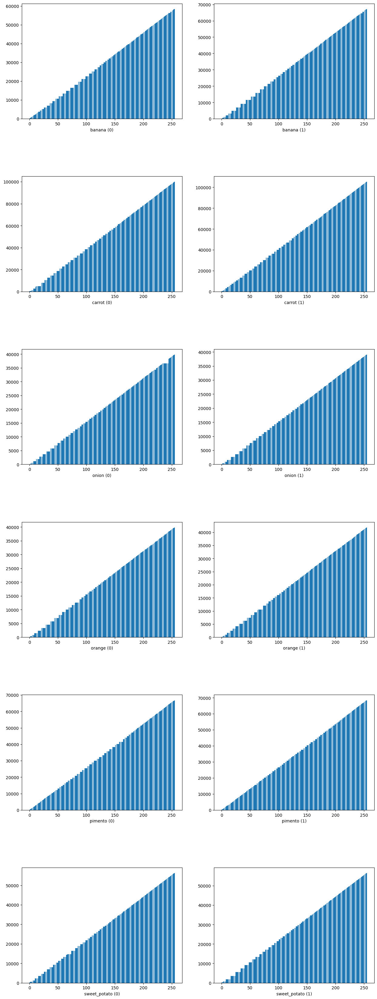

In [42]:
print('Sum_Histogram')
fig, axs = plt_setting(len(simgs))

x = np.arange(256)
for i, ax in enumerate(axs.flat):
    
    text = f'{crop_names[i//2]} ({i%2})'
    ax.set_xlabel(text) 
    ax.bar(x, np.cumsum(himg_hists[i]))

#### Conclusion
<img src="https://velog.velcdn.com/images%2Fredorangeyellowy%2Fpost%2F72afa492-6c99-44a9-b7d7-e8a90933561b%2Fimage.png" width="80%" />

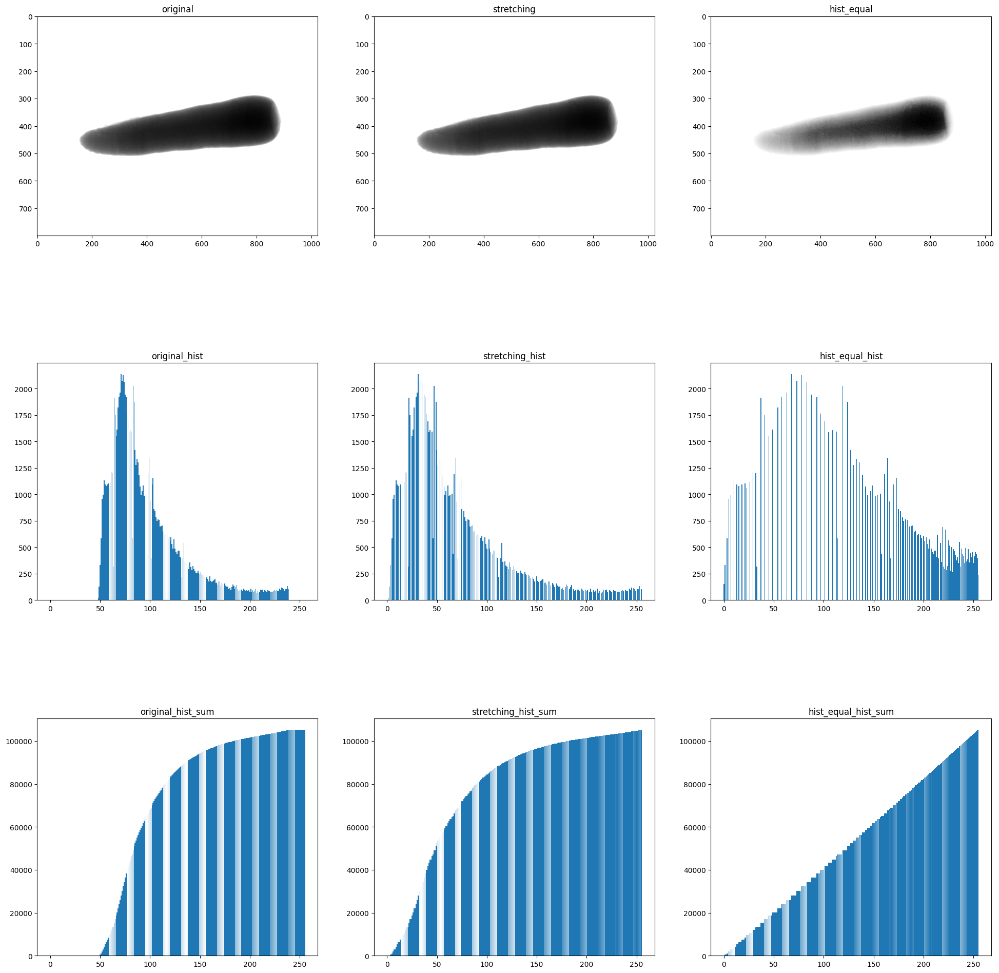

In [43]:
idx = 3

fig, axs = plt_setting(9, 3, 24, 24)

img_list = [basic_imgs[idx], simgs[idx], himgs[idx]]
name_list = ['original', 'stretching', 'hist_equal']
for c, (img, name) in enumerate(zip(img_list, name_list)):
    axs[0, c].set_title(name)
    axs[0, c].imshow(img, cmap=plt.cm.gray)
    
hist_list = [bimg_hists[idx], simg_hists[idx], himg_hists[idx]]
name_list = ['original_hist', 'stretching_hist', 'hist_equal_hist']
x = np.arange(256)
for c, hist in enumerate(hist_list):
    axs[1, c].set_title(name_list[c])
    axs[1, c].bar(x, hist)
    axs[2, c].set_title(name_list[c] + '_sum')
    axs[2, c].bar(x, np.cumsum(hist))

    

## Derive Pseudo Algorithm

In [44]:
# 과일 종류별로 이미지 리스트 만들기
banana_list = images[('banana', 0)] + images[('banana', 1)]
carrot_list = images[('carrot', 0)] + images[('carrot', 1)]
onion_list = images[('onion', 0)] + images[('onion', 1)]
orange_list = images[('orange', 0)] + images[('orange', 1)]
pimento_list = images[('pimento', 0)] + images[('pimento', 1)]
sweet_potato_list = images[('sweet_potato', 0)] + images[('sweet_potato', 1)]

`bimg`: 이진화화 열림연산을 한 이진 이미지  
`basic_info`: `bimg`에서 실질적인 부분 픽셀 부분은 1, 그렇지 않은 픽셀(노이즈/배경)은 0인 2차원 정보(이미지)  
`basic_img`: `basic_info`를 이용해서 실질적인 부분은 그대로 유지, 그렇지 않은 부분은 흰색(255)으로 지정한 이미지  
`stretching_img`: `basic_img`에 스트레칭 평활화한 이미지  

In [45]:
# banana
banana_bimgs = [convert_binary_oppening(img, 240, 5) for img in banana_list]
banana_basic_infos = [np.where(bimg==0, 1, 0) for bimg in banana_bimgs]
banana_basic_imgs = [np.where(info==1, img, MAX) for img, info in zip(banana_list, banana_basic_infos)]
banana_stretching_imgs = [stretching(img, info) for img, info in zip(banana_basic_imgs, banana_basic_infos)]

# carrot
carrot_bimgs = [convert_binary_oppening(img, 240, 5) for img in carrot_list]
carrot_basic_infos = [np.where(bimg==0, 1, 0) for bimg in carrot_bimgs]
carrot_basic_imgs = [np.where(info==1, img, MAX) for img, info in zip(carrot_list, carrot_basic_infos)]
carrot_stretching_imgs = [stretching(img, info) for img, info in zip(carrot_basic_imgs, carrot_basic_infos)]

# onion
onion_bimgs = [convert_binary_oppening(img, 240, 5) for img in onion_list]
onion_basic_infos = [np.where(bimg==0, 1, 0) for bimg in onion_bimgs]
onion_basic_imgs = [np.where(info==1, img, MAX) for img, info in zip(onion_list, onion_basic_infos)]
onion_stretching_imgs = [stretching(img, info) for img, info in zip(onion_basic_imgs, onion_basic_infos)]

# orange
orange_bimgs = [convert_binary_oppening(img, 240, 5) for img in orange_list]
orange_basic_infos = [np.where(bimg==0, 1, 0) for bimg in orange_bimgs]
orange_basic_imgs = [np.where(info==1, img, MAX) for img, info in zip(orange_list, orange_basic_infos)]
orange_stretching_imgs = [stretching(img, info) for img, info in zip(orange_basic_imgs, orange_basic_infos)]

# pimento
pimento_bimgs = [convert_binary_oppening(img, 240, 5) for img in pimento_list]
pimento_basic_infos = [np.where(bimg==0, 1, 0) for bimg in pimento_bimgs]
pimento_basic_imgs = [np.where(info==1, img, MAX) for img, info in zip(pimento_list, pimento_basic_infos)]
pimento_stretching_imgs = [stretching(img, info) for img, info in zip(pimento_basic_imgs, pimento_basic_infos)]

# sweet_potato
sweet_potato_bimgs = [convert_binary_oppening(img, 240, 5) for img in sweet_potato_list]
sweet_potato_basic_infos = [np.where(bimg==0, 1, 0) for bimg in sweet_potato_bimgs]
sweet_potato_basic_imgs = [np.where(info==1, img, MAX) for img, info in zip(sweet_potato_list, sweet_potato_basic_infos)]
sweet_potato_stretching_imgs = [stretching(img, info) for img, info in zip(sweet_potato_basic_imgs, sweet_potato_basic_infos)]

### 이진화를 이용한 결함 시각화

In [46]:
def binary_visual(img, info, flag=150):
    height, width = img.shape
    output = np.ones(shape=(height, width, 3), dtype=int) * 255
    
    for r in range(height):
        for c in range(width):
            if info[r, c] == 0: 
                continue
                
            if img[r, c] >= flag: # Red (밀도↓)
                v = min(int(((255 - img[r, c]) / (255 - flag)) * 255), 255)
                output[r, c, 0] = 255  # R
                output[r, c, 1] = v  # G
                output[r, c, 2] = v  # B
            else: # Blue (밀도↑)
                v = min(int((img[r, c] / flag) * 255), 255)
                output[r, c, 0] = v  # R
                output[r, c, 1] = v  # G
                output[r, c, 2] = 255  # B
            
    output = np.array(output, dtype=np.uint8)
    return output
    
    

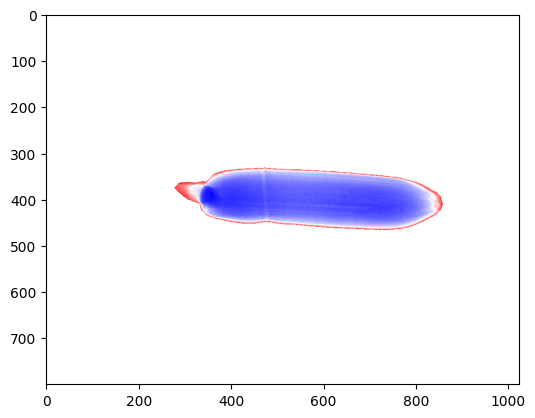

In [47]:
ret = binary_visual(banana_stretching_imgs[0], banana_basic_infos[0])
plt.imshow(ret, cmap=plt.cm.gray)

#### banana

In [136]:
thresholds = 0
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [137]:
thresholds = 10
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [138]:
thresholds = 20
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [139]:
thresholds = 30
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [140]:
thresholds = 40
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [141]:
thresholds = 50
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

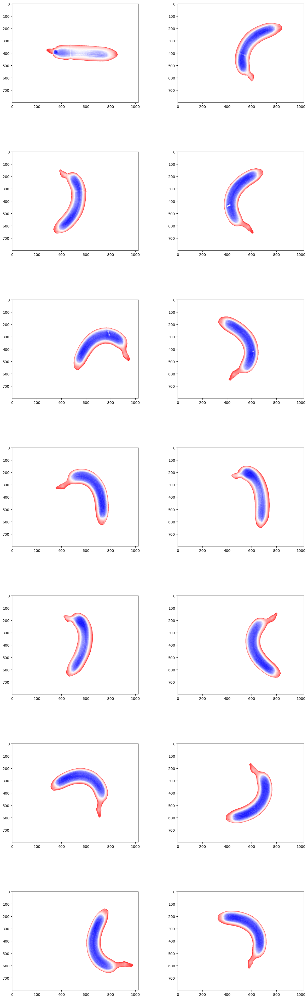

In [49]:
thresholds = 60
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [143]:
thresholds = 70
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [144]:
thresholds = 80
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [145]:
thresholds = 90
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [146]:
thresholds = 100
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [147]:
thresholds = 110
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [148]:
thresholds = 120
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [149]:
thresholds = 130
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [150]:
thresholds = 140
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [151]:
thresholds = 150
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [152]:
thresholds = 160
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [153]:
thresholds = 170
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [154]:
thresholds = 180
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [155]:
thresholds = 190
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [156]:
thresholds = 200
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [157]:
thresholds = 210
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [158]:
thresholds = 220
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [159]:
thresholds = 230
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [160]:
thresholds = 240
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [161]:
thresholds = 250
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, info, ax in zip(banana_stretching_imgs, banana_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### carrot

In [162]:
thresholds = 0
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [163]:
thresholds = 10
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [164]:
thresholds = 20
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [165]:
thresholds = 30
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [166]:
thresholds = 40
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [167]:
thresholds = 50
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

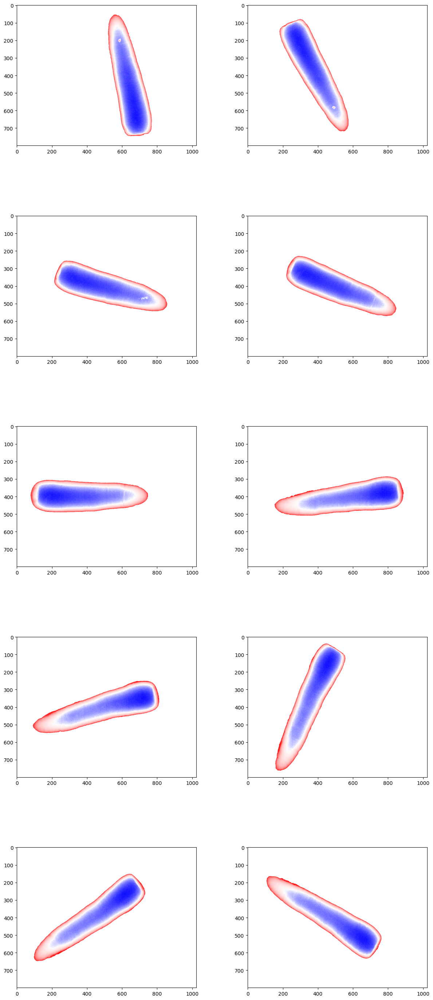

In [50]:
thresholds = 60
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [169]:
thresholds = 70
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [170]:
thresholds = 80
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [171]:
thresholds = 90
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [172]:
thresholds = 100
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [173]:
thresholds = 110
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [174]:
thresholds = 120
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [175]:
thresholds = 130
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [176]:
thresholds = 140
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [177]:
thresholds = 150
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [179]:
thresholds = 160
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [180]:
thresholds = 170
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [181]:
thresholds = 180
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [182]:
thresholds = 190
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [183]:
thresholds = 200
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [184]:
thresholds = 210
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [185]:
thresholds = 220
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [186]:
thresholds = 230
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [187]:
thresholds = 240
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [188]:
thresholds = 250
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, info, ax in zip(carrot_stretching_imgs, carrot_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### onion

In [56]:
thresholds = 0
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [190]:
thresholds = 10
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [191]:
thresholds = 20
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [57]:
thresholds = 30
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [193]:
thresholds = 40
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [194]:
thresholds = 50
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

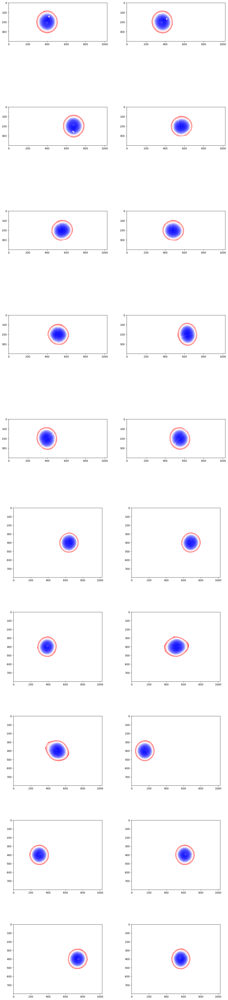

In [51]:
thresholds = 60
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [196]:
thresholds = 70
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [197]:
thresholds = 80
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [198]:
thresholds = 90
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [199]:
thresholds = 100
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [200]:
thresholds = 110
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [201]:
thresholds = 120
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [202]:
thresholds = 130
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [203]:
thresholds = 140
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [204]:
thresholds = 150
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [205]:
thresholds = 160
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [206]:
thresholds = 170
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [207]:
thresholds = 180
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [208]:
thresholds = 190
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [209]:
thresholds = 200
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [210]:
thresholds = 210
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [211]:
thresholds = 220
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [212]:
thresholds = 230
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [213]:
thresholds = 240
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [214]:
thresholds = 250
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, info, ax in zip(onion_stretching_imgs, onion_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### orange

In [215]:
thresholds = 0
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [216]:
thresholds = 10
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [217]:
thresholds = 20
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [218]:
thresholds = 30
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [219]:
thresholds = 40
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [220]:
thresholds = 50
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

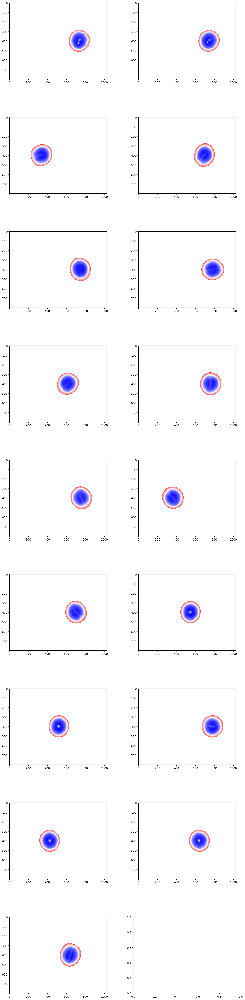

In [52]:
thresholds = 60
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [222]:
thresholds = 70
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [223]:
thresholds = 80
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [224]:
thresholds = 90
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [225]:
thresholds = 100
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [226]:
thresholds = 110
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [227]:
thresholds = 120
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [228]:
thresholds = 130
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [229]:
thresholds = 140
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [230]:
thresholds = 150
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [231]:
thresholds = 160
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [232]:
thresholds = 170
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [233]:
thresholds = 180
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [234]:
thresholds = 190
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [235]:
thresholds = 200
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [236]:
thresholds = 210
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [237]:
thresholds = 220
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [238]:
thresholds = 230
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [239]:
thresholds = 240
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [240]:
thresholds = 250
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, info, ax in zip(orange_stretching_imgs, orange_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### pimento

In [241]:
thresholds = 0
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [242]:
thresholds = 10
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [243]:
thresholds = 20
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [244]:
thresholds = 30
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [245]:
thresholds = 40
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [246]:
thresholds = 50
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

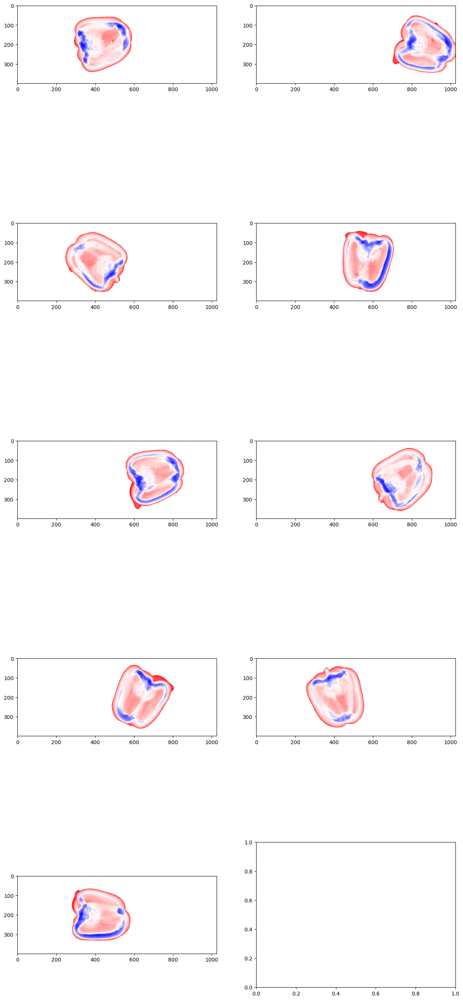

In [53]:
thresholds = 60
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [248]:
thresholds = 70
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [249]:
thresholds = 80
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [250]:
thresholds = 90
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [251]:
thresholds = 100
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [252]:
thresholds = 110
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [253]:
thresholds = 120
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [254]:
thresholds = 130
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [255]:
thresholds = 140
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [256]:
thresholds = 150
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [257]:
thresholds = 160
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [258]:
thresholds = 170
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [259]:
thresholds = 180
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [260]:
thresholds = 190
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [261]:
thresholds = 200
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [262]:
thresholds = 210
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [263]:
thresholds = 220
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [264]:
thresholds = 230
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [265]:
thresholds = 240
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [266]:
thresholds = 250
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, info, ax in zip(pimento_stretching_imgs, pimento_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### sweet_potato

In [267]:
thresholds = 0
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [268]:
thresholds = 10
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [269]:
thresholds = 20
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [270]:
thresholds = 30
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [271]:
thresholds = 40
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [272]:
thresholds = 50
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

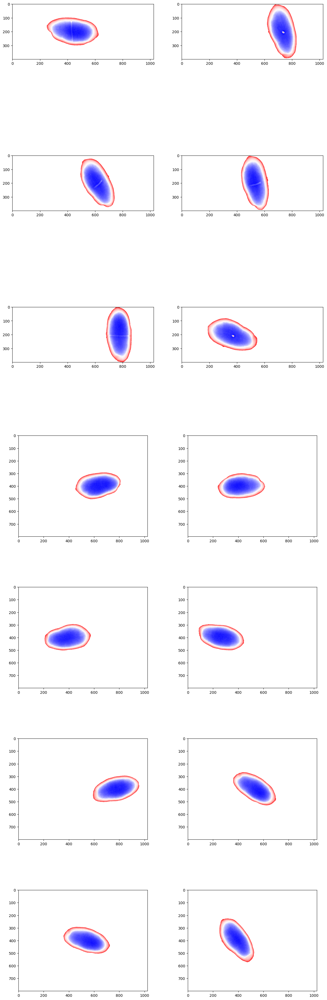

In [54]:
thresholds = 60
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [274]:
thresholds = 70
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [275]:
thresholds = 80
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [276]:
thresholds = 90
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [277]:
thresholds = 100
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [278]:
thresholds = 110
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [279]:
thresholds = 120
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [280]:
thresholds = 130
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [281]:
thresholds = 140
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [282]:
thresholds = 150
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [283]:
thresholds = 160
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [284]:
thresholds = 170
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [285]:
thresholds = 180
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [286]:
thresholds = 190
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [287]:
thresholds = 200
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [288]:
thresholds = 210
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [289]:
thresholds = 220
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [290]:
thresholds = 230
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [291]:
thresholds = 240
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [292]:
thresholds = 250
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, info, ax in zip(sweet_potato_stretching_imgs, sweet_potato_basic_infos, axs.flat):
    img = binary_visual(img, info, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

### 지역 정보를 이용하여 결함 시각화

In [55]:
def psudo(img, flag=0.0):
    num = 0
#     print(img.shape)
    height, width = img.shape
    s = np.zeros((height, width)).astype('float')

    alpha = 100 # 색상 선택을 위한 용도
    scale = 20 # n x n WAM 필터의 크기
    output = np.ones(shape=(height, width, 3), dtype=int) * 255 # 출력용 이미지
    
    pss = np.zeros((height+1, width+1), dtype=np.int64)
    ps = np.zeros((height+1, width+1), dtype=np.int64)
    
    
    for i in range(1, height+1):
        for j in range(1, width+1):
            num += 1
            ps[i, j] = ps[i-1][j] + ps[i][j-1] - ps[i-1][j-1] + img[i-1, j-1]
            pss[i, j] = pss[i-1][j] + pss[i][j-1] - pss[i-1][j-1] + np.int64(img[i-1, j-1])*img[i-1, j-1]
        
    
    # RD 이미지 생성
    for r in range(20, height - 20):
        for c in range(20, width - 20):
            num += 1
            i = r + 1;
            j = c + 1;
            # 한 픽셀에 대해 주변 40*40 범위의 평균과 표준편차를 구해 주변보다 밀도가 얼마나 차이나는지 구함
            try:
                if img[r, c] < 200:
                    wam = (ps[i + scale][j + scale] - ps[i - scale-1][j + scale] - ps[i + scale][j - scale-1] + ps[i - scale-1][j - scale-1]) / (41 * 41)
                    lam = (ps[i+2][j+2] - ps[i-2-1][j+2] - ps[i+2][j-2-1] + ps[i-2-1][j-2-1]) / (5 * 5)
                    
                    sq_sum = pss[i + scale][j + scale] - pss[i - scale-1][j + scale] - pss[i + scale][j - scale-1] + pss[i - scale-1][j - scale-1]
                    sq_sum_avg = sq_sum / (41 * 41)
                    std = math.sqrt(sq_sum_avg - wam*wam)

                    z = round((lam - wam) / std, 2)
                    s[r, c] = z
                    
                    if 0 < z < flag:
                        z *= -1.0
        
                    if z > 0:  # Red
                        v = max(0, 255 - int(alpha * z))
                        output[r, c, 0] = 255  # R
                        output[r, c, 1] = v  # G
                        output[r, c, 2] = v  # B
                    else:
                        v = max(0, 255 + int(alpha * z))
                        output[r, c, 0] = v  # R
                        output[r, c, 1] = v  # G
                        output[r, c, 2] = 255  # B
            except:
                pass
    print(num)
    return output

In [56]:
import time
import math

start = time.time()
ret = psudo(banana_stretching_imgs[0])
end = time.time()

print(f'{end - start:.5f} sec')


1567040
4.22157 sec


#### banana

1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040


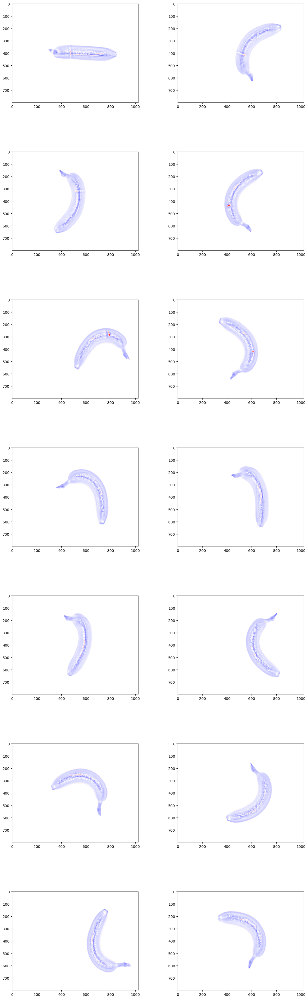

In [57]:
thresholds = 0.0 
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [305]:
thresholds = 0.2 
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [304]:
thresholds = 0.4
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [112]:
thresholds = 0.6
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [113]:
thresholds = 0.8
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [114]:
thresholds = 1.0
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [115]:
thresholds = 1.2
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [116]:
thresholds = 1.4
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [117]:
thresholds = 1.6
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [118]:
thresholds = 1.8
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [119]:
thresholds = 2.0
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [175]:
thresholds = 2.2
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [176]:
thresholds = 2.4
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [177]:
thresholds = 2.6
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [178]:
thresholds = 2.8
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [179]:
thresholds = 3.0
fig, axs = plt_setting(len(banana_stretching_imgs))

for img, ax in zip(banana_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### carrot

1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040


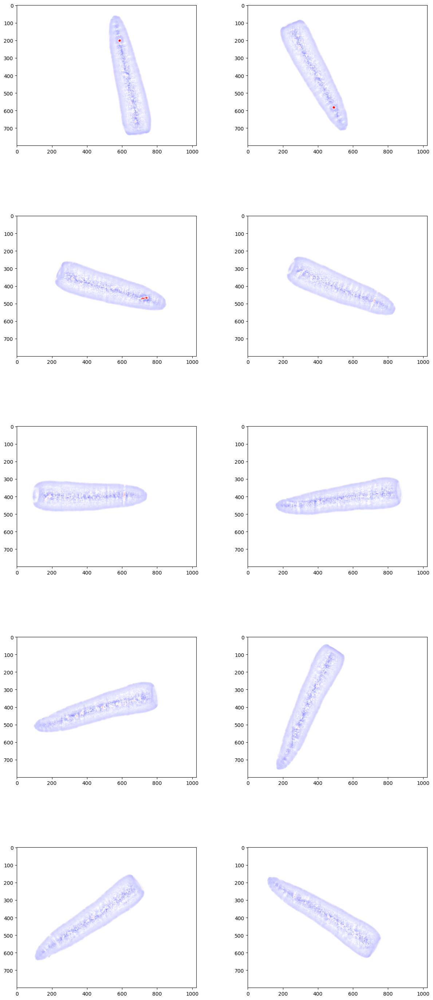

In [58]:
thresholds = 0.0
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [121]:
thresholds = 0.2
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [122]:
thresholds = 0.4
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [123]:
thresholds = 0.6
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [124]:
thresholds = 0.8
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [125]:
thresholds = 1.0
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [126]:
thresholds = 1.2
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [127]:
thresholds = 1.4
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [128]:
thresholds = 1.6
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [129]:
thresholds = 1.8
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [130]:
thresholds = 2.0
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [180]:
thresholds = 2.2
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [181]:
thresholds = 2.4
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [182]:
thresholds = 2.6
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [183]:
thresholds = 2.8
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [184]:
thresholds = 3.0
fig, axs = plt_setting(len(carrot_stretching_imgs))

for img, ax in zip(carrot_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### onion

763840
763840
763840
763840
763840
763840
763840
763840
763840
763840
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040


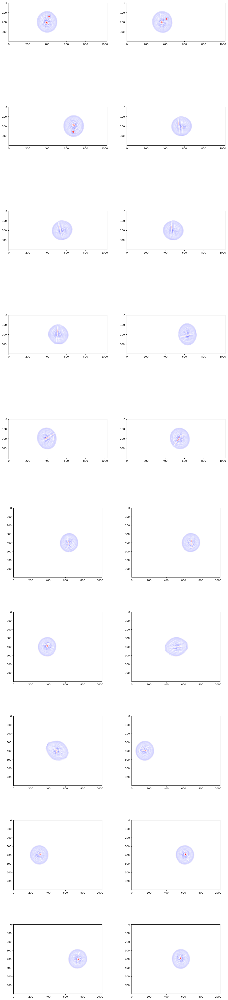

In [59]:
thresholds = 0.0
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [132]:
thresholds = 0.2
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [133]:
thresholds = 0.4
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [134]:
thresholds = 0.6
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [135]:
thresholds = 0.8
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [136]:
thresholds = 1.0
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [137]:
thresholds = 1.2
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [138]:
thresholds = 1.4
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [139]:
thresholds = 1.6
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [140]:
thresholds = 1.8
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [141]:
thresholds = 2.0
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [185]:
thresholds = 2.2
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [186]:
thresholds = 2.4
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [187]:
thresholds = 2.6
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [188]:
thresholds = 2.8
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [189]:
thresholds = 3.0
fig, axs = plt_setting(len(onion_stretching_imgs))

for img, ax in zip(onion_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### orange

1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040


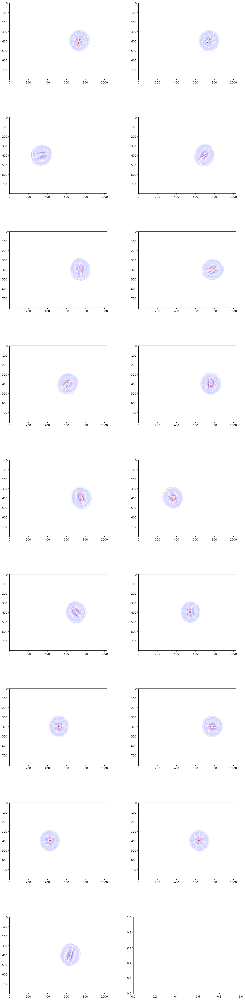

In [60]:
thresholds = 0.0
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [143]:
thresholds = 0.2
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [144]:
thresholds = 0.4
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [145]:
thresholds = 0.6
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [146]:
thresholds = 0.8
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [147]:
thresholds = 1.0
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [148]:
thresholds = 1.2
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [149]:
thresholds = 1.4
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [150]:
thresholds = 1.6
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [151]:
thresholds = 1.8
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [152]:
thresholds = 2.0
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [190]:
thresholds = 2.2
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [191]:
thresholds = 2.4
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [192]:
thresholds = 2.6
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [193]:
thresholds = 2.8
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [194]:
thresholds = 3.0
fig, axs = plt_setting(len(orange_stretching_imgs))

for img, ax in zip(orange_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### pimento

763840
763840
763840
763840
763840
763840
763840
763840
763840


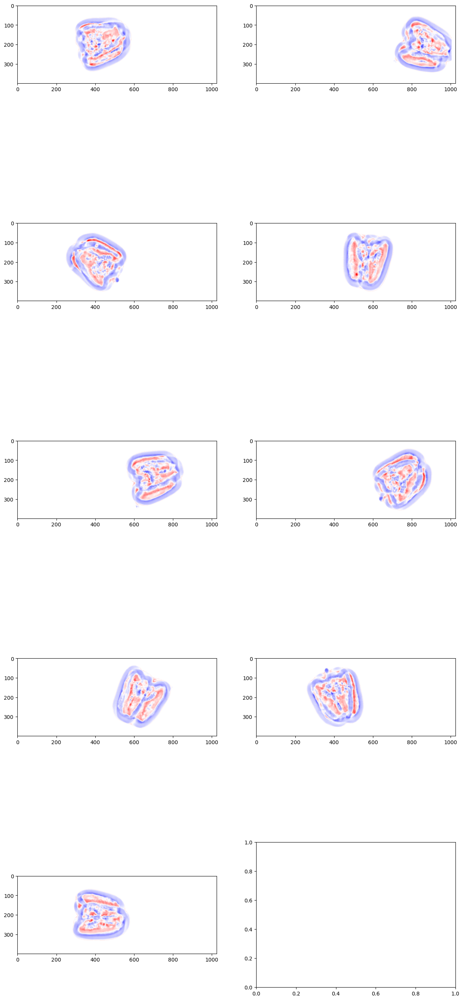

In [61]:
thresholds = 0.0
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [154]:
thresholds = 0.2
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [155]:
thresholds = 0.4
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [156]:
thresholds = 0.6
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [157]:
thresholds = 0.8
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [158]:
thresholds = 1.0
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [159]:
thresholds = 1.2
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [160]:
thresholds = 1.4
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [161]:
thresholds = 1.6
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [162]:
thresholds = 1.8
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [163]:
thresholds = 2.0
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [195]:
thresholds = 2.2
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [196]:
thresholds = 2.4
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [197]:
thresholds = 2.6
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [198]:
thresholds = 2.8
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [199]:
thresholds = 3.0
fig, axs = plt_setting(len(pimento_stretching_imgs))

for img, ax in zip(pimento_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

#### sweet_potato

763840
763840
763840
763840
763840
763840
1567040
1567040
1567040
1567040
1567040
1567040
1567040
1567040


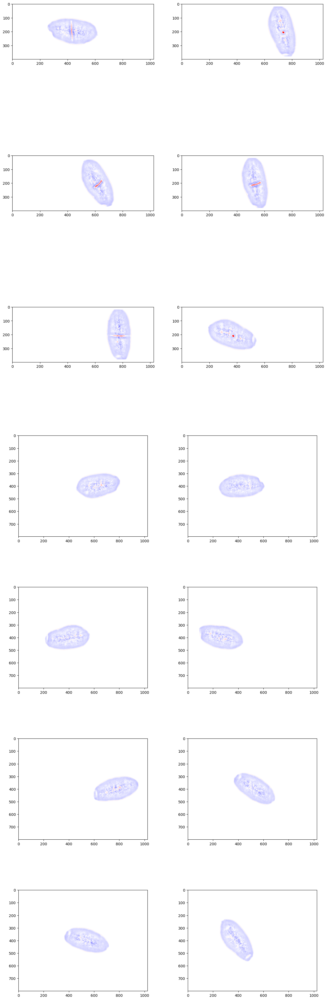

In [62]:
thresholds = 0.0
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [165]:
thresholds = 0.2
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [166]:
thresholds = 0.4
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [167]:
thresholds = 0.6
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [168]:
thresholds = 0.8
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [169]:
thresholds = 1.0
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [170]:
thresholds = 1.2
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [171]:
thresholds = 1.4
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [172]:
thresholds = 1.6
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [173]:
thresholds = 1.8
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [174]:
thresholds = 2.0
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [200]:
thresholds = 2.2
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [201]:
thresholds = 2.4
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [202]:
thresholds = 2.6
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [203]:
thresholds = 2.8
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

In [204]:
thresholds = 3.0
fig, axs = plt_setting(len(sweet_potato_stretching_imgs))

for img, ax in zip(sweet_potato_stretching_imgs, axs.flat):
    img = psudo(img, thresholds)
    ax.imshow(img, cmap=plt.cm.gray)

## 결함 검출 알고리즘

이 부분은 스파이더 개발환경에서 수행하였으므로 함수만 첨부하였음

In [63]:
@jit(nopython=True)
def cal_center(img):
    h, w = img.shape
    
    sum_y = 0
    sum_x = 0
    num = 0
    
    for i in range(h):
        for j in range(w):
            if img[i, j] != 255:
                sum_y += i
                sum_x += j
                num += 1
                
    mid_y = sum_y // num
    mid_x = sum_x // num
    
    return mid_y, mid_x


In [64]:
@jit(nopython=True)
def dfs(y, x, visited, cur_size, y_min, x_min, y_max, x_max, dy, dx, h, w, defect_pixels_matrix):
    if visited[y][x]:
        return int(1e5), int(1e5), -1, -1, 0

    visited[y][x] = True
    
    y_min = y_max = y
    x_min = x_max = x
    cur_size = 1

    for i in range(4):
        ny = y + dy[i]
        nx = x + dx[i]
        adj_size = 0
        if 0 <= ny < h and 0 <= nx < w and defect_pixels_matrix[ny][nx]:
            ny_min, nx_min, ny_max, nx_max, n_size = dfs(ny, nx, visited, cur_size, y_min, x_min, y_max, x_max, dy, dx, h, w, defect_pixels_matrix)
            cur_size += n_size
            y_min = min(y_min, ny_min)
            y_max = max(y_max, ny_max)
            x_min = min(x_min, nx_min)
            x_max = max(x_max, nx_max)

    return y_min, x_min, y_max, x_max, cur_size


In [65]:
@jit(nopython=True)
def get_defect_candidates(pseudo_img, th1=0.9, th2=0.8):
    pixel_range = np.max(pseudo_img)
    h, w, _ = pseudo_img.shape
    
    num = 0
    defect_pixels = [[-1, -1] for _ in range(100000)]
    defect_pixels_matrix = [[False for j in range(w)] for _ in range(h)]
    for i in range(h):
        for j in range(w):
            if pseudo_img[i][j][0] > pixel_range * th1 and pseudo_img[i][j][1] < pixel_range * th2:
                defect_pixels[num] = [i, j]
                defect_pixels_matrix[i][j] = True
                num += 1
    
    dy = [-1, 0, 1, 0]
    dx = [0, 1, 0, -1]
    visited = [[False for j in range(w)] for _ in range(h)]
    candidates_info = [[0, 0, 0, 0, 0] for _ in range(10000)]
    
    cur_size = 0
    y_min = x_min = int(1e5)
    y_max = x_max = -1
    
    candidates_num = 0
    for i, j in defect_pixels[:num]:
        if visited[i][j]:
            continue
        y_min, x_min, y_max, x_max, cur_size = dfs(i, j, visited, cur_size, y_min, x_min, y_max, x_max, dy ,dx, h, w, defect_pixels_matrix)
        candidates_info[candidates_num] = [y_min, x_min, y_max, x_max, cur_size]
        candidates_num += 1
        
        cur_size = 0
        y_min = x_min = int(1e5)
        y_max = x_max = -1
    
    ret = candidates_info[:candidates_num]
    ret.sort(key = lambda x : -x[4])
    
    return ret


In [66]:
@jit(nopython=True)
def defect_detection(img, info, flag=0.0, radius=0.0, option=1.0):
    num = 0
    height, width = img.shape

    alpha = 100 # 색상 선택을 위한 용도
    scale = 20 # n x n WAM 필터의 크기
    output = [[[255, 255, 255] for j in range(width)] for i in range(height)]
    
    pss = [[0]*(width+1) for _ in range(height+1)]
    ps = [[0]*(width+1) for _ in range(height+1)]
    
    for i in range(1, height+1):
        for j in range(1, width+1):
            num += 1
            ps[i][j] = ps[i-1][j] + ps[i][j-1] - ps[i-1][j-1] + img[i-1, j-1]
            pss[i][j] = pss[i-1][j] + pss[i][j-1] - pss[i-1][j-1] + np.int64(img[i-1, j-1])*img[i-1, j-1]
        
    if radius != 0.0:
        mid_y, mid_x = cal_center(img)
    
    p = 5
    q = 10
    
    # RD 이미지 생성
    for r in range(20, height - 20):
        for c in range(20, width - 20):
            num += 1
            i = r + 1;
            j = c + 1;

            # 한 픽셀에 대해 주변 40*40 범위의 평균과 표준편차를 구해 주변보다 밀도가 얼마나 차이나는지 구함
            try:
                if info[r, c] == 1 and img[r, c] < 200:
                    wam = (ps[i + scale][j + scale] - ps[i - scale-1][j + scale] - ps[i + scale][j - scale-1] + ps[i - scale-1][j - scale-1]) / (41 * 41)
                    lam = (ps[i+2][j+2] - ps[i-2-1][j+2] - ps[i+2][j-2-1] + ps[i-2-1][j-2-1]) / (5 * 5)
                    
                    sq_sum = pss[i + scale][j + scale] - pss[i - scale-1][j + scale] - pss[i + scale][j - scale-1] + pss[i - scale-1][j - scale-1]
                    sq_sum_avg = sq_sum / (41 * 41)
                    std = math.sqrt(sq_sum_avg - wam*wam)

                    z = round((lam - wam) / std, 2)
                    
                    if info[r, c] == 1:
                        C = (ps[i+1][j+1] - ps[i-1-1][j+1] - ps[i+1][j-1-1] + ps[i-1-1][j-1-1]) / (3 * 3)
                        
                        # row
                        A = (ps[i][j+p] - ps[i][j-p-1] - ps[i-q-1][j+p] + ps[i-q-1][j-p-1]) / ((2*p+1) * (q+1))
                        B = (ps[i+q][j+p] - ps[i+q][j-p-1] - ps[i-1][j+p] + ps[i-1][j-p-1]) / ((2*p+1) * (q+1))
                        A_std = math.sqrt((pss[i][j+p] - pss[i][j-p-1] - pss[i-q-1][j+p] + pss[i-q-1][j-p-1]) / ((2*p+1) * (q+1)) - A**2)
                        B_std = math.sqrt((pss[i+q][j+p] - pss[i+q][j-p-1] - pss[i-1][j+p] + pss[i-1][j-p-1]) / ((2*p+1) * (q+1)) - B**2)
                        
                        if abs(C-A) < abs(C-B):
                            val = round((A-B) / A_std, 2)
                        else:
                            val = round((B-A) / B_std, 2)
                        
                        # column
                        A = (ps[i+p][j] - ps[i-p-1][j] - ps[i+p][j-q-1] + ps[i-p-1][j-q-1]) / ((2*p+1) * (q+1))
                        B = (ps[i+p][j+q] - ps[i-p-1][j+q] - ps[i+p][j-1] + ps[i-p-1][j-1]) / ((2*p+1) * (q+1))
                        A_std = math.sqrt((pss[i+p][j] - pss[i-p-1][j] - pss[i+p][j-q-1] + pss[i-p-1][j-q-1]) / ((2*p+1) * (q+1)) - A**2)
                        B_std = math.sqrt((pss[i+p][j+q] - pss[i-p-1][j+q] - pss[i+p][j-1] + pss[i-p-1][j-1]) / ((2*p+1) * (q+1)) - B**2)
                        
                        if abs(C-A) < abs(C-B):
                            val += round((A-B) / A_std, 2)
                        else:
                            val += round((B-A) / B_std, 2)
                        
                        if val > 0:
                            z += val / option
                    
                    if 0 < z < flag:
                        z *= -1.0
                        
                    # orange, onion
                    if radius > 0.0:
                        dist = math.sqrt((mid_y-r)**2 + (mid_x-c)**2)
                        if dist <= radius:
                            z = -abs(z)    
                    
                    if z > 0:  # Red
                        v = max(0, 255 - int(alpha * z))
                        output[r][c][0] = 255  # R
                        output[r][c][1] = v  # G
                        output[r][c][2] = v  # B
                    else: # Blue
                        v = max(0, 255 + int(alpha * z))
                        output[r][c][0] = v  # R
                        output[r][c][1] = v  # G
                        output[r][c][2] = 255  # B
            except:
                pass
    output = np.array(output, dtype=np.uint8)
    
    ret = output
    defect_candidates = get_defect_candidates(ret, 0.9, 0.8)

    # 색상 및 굵기
    p = (50, 100, 0) # RGB, Box Colour
    lt = 5 # line thickness
    for y_min, x_min, y_max, x_max, pixel_num in defect_candidates:
        if pixel_num <= 50: 
            continue
        
        if y_max - y_min <= 3 or x_max - x_min <= 3:
            continue
        
        y_min -= 10
        x_min -= 10
        y_max += 10
        x_max += 10
    
        # -
        ret[y_min:y_min+lt, x_min:x_max+lt, 0] = p[0]
        ret[y_min:y_min+lt, x_min:x_max+lt, 1] = p[1]
        ret[y_min:y_min+lt, x_min:x_max+lt, 2] = p[2]
        
        # _
        ret[y_max:y_max+lt, x_min:x_max+lt, 0] = p[0]
        ret[y_max:y_max+lt, x_min:x_max+lt, 1] = p[1]
        ret[y_max:y_max+lt, x_min:x_max+lt, 2] = p[2]
        
        # |
        ret[y_min:y_max+lt, x_min:x_min+lt, 0] = p[0]
        ret[y_min:y_max+lt, x_min:x_min+lt, 1] = p[1]
        ret[y_min:y_max+lt, x_min:x_min+lt, 2] = p[2]
        
        #   |
        ret[y_min:y_max+lt, x_max:x_max+lt, 0] = p[0]
        ret[y_min:y_max+lt, x_max:x_max+lt, 1] = p[1]
        ret[y_min:y_max+lt, x_max:x_max+lt, 2] = p[2]
        
        break
        
    return ret


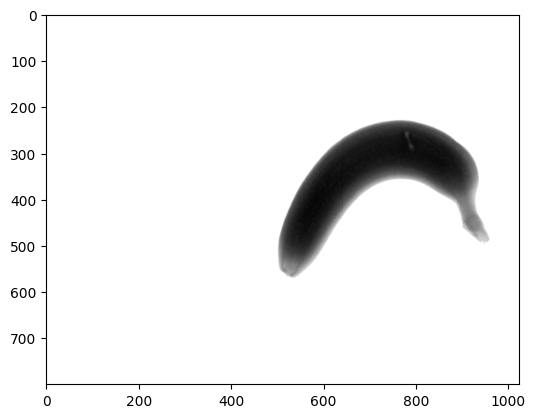

In [67]:
plt.imshow(banana_stretching_imgs[4], cmap=plt.cm.gray)

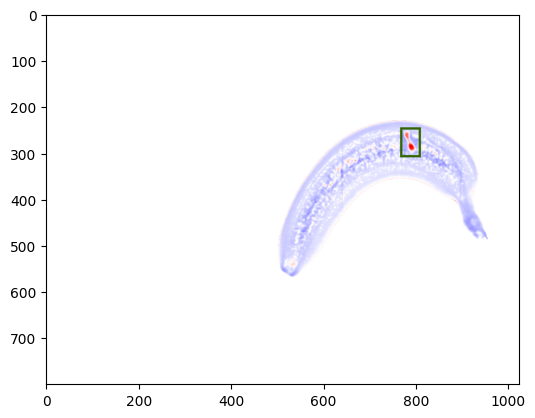

In [68]:
img = defect_detection(banana_stretching_imgs[4], banana_basic_infos[4], 0.0, 0.0, 16.0)
plt.imshow(img)